<a href="https://colab.research.google.com/github/YounSooKimTech/Joy_Profile_Photos/blob/main/Yale_University_Preprocessing.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Meta Dataset

In [ ]:
df_department =[]
df_name =[]
df_title =[]
df_link =[]
df_url = []

import pandas as pd
import requests
from bs4 import BeautifulSoup

url = "https://som.yale.edu/faculty-research/faculty-directory"
response = requests.get(url)
#print(url, response)
soup = BeautifulSoup(response.content, 'html.parser')

div_tags = soup.find_all("div", class_="faculty-teaser-list-view__group")

for div_tag in div_tags:
  a_tags = div_tag.find_all("a")
  for a_tag in a_tags:
    name = a_tag.get_text().strip()
    href = a_tag["href"]
    url = f"https://som.yale.edu{href}"
    df_name.append(name)
    df_url.append(url)
    #print(name, ":", url)

df_meta = pd.DataFrame({"Name":df_name,
                     "URL":df_url})

df_meta.head()

,Name,URL
0,Jason Abaluck,https://som.yale.edu/faculty-research/faculty-...
1,Laura Adler,https://som.yale.edu/faculty-research/faculty-...
2,Rick Antle,https://som.yale.edu/faculty-research/faculty-...
3,Jaime Arellano-Bover,https://som.yale.edu/faculty-research/faculty-...
4,David Argente,https://som.yale.edu/faculty-research/faculty-...


In [ ]:
import requests
from bs4 import BeautifulSoup

df_title = []

for index, row in df_meta.iterrows():
    name = row["Name"]
    url = row["URL"]
    response = requests.get(url)
    soup = BeautifulSoup(response.content, 'html.parser')

    p_tag = soup.find("p", class_ = "node__job-title")
    title = p_tag.get_text().strip()

    df_title.append(title)

    #print(name, ":", title)

df_meta["Title"] = df_title

df_meta.head(3)

,Name,URL,Title
0,Jason Abaluck,https://som.yale.edu/faculty-research/faculty-...,Professor of Economics
1,Laura Adler,https://som.yale.edu/faculty-research/faculty-...,Assistant Professor of Organizational Behavior
2,Rick Antle,https://som.yale.edu/faculty-research/faculty-...,William S. Beinecke Professor of Accounting


In [ ]:
df_meta.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 236 entries, 0 to 235
Data columns (total 3 columns):
 #   Column  Non-Null Count  Dtype 
---  ------  --------------  ----- 
 0   Name    236 non-null    object
 1   URL     236 non-null    object
 2   Title   236 non-null    object
dtypes: object(3)
memory usage: 5.7+ KB


## Filter the dataset

In [ ]:
df_SOM = df_meta.head(105) # <- Exclude Affiliated Faculty, Visiting Instructors & Scholars, Emeriti

df_SOM_prof = df_SOM[~df_SOM["Title"].str.contains("Lecturer|Visiting|Practice")]

df_SOM_prof.head(3)

,Name,URL,Title
0,Jason Abaluck,https://som.yale.edu/faculty-research/faculty-...,Professor of Economics
1,Laura Adler,https://som.yale.edu/faculty-research/faculty-...,Assistant Professor of Organizational Behavior
2,Rick Antle,https://som.yale.edu/faculty-research/faculty-...,William S. Beinecke Professor of Accounting


In [ ]:
import numpy as np

conditions = [
    df_SOM_prof["Title"].str.contains("Emeritus"),
    df_SOM_prof["Title"].str.contains("Emerita"),
    df_SOM_prof["Title"].str.contains("Assistant"),
    df_SOM_prof["Title"].str.contains("Associate")
]

choices = ["Emeritus", "Emeritus", "Assistant", "Associate"]

df_SOM_prof["Rank"] = np.select(conditions, choices, default="Full")

df_SOM_prof["Rank"].value_counts()

<ipython-input-5-b0d3f1f0795b>:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_SOM_prof["Rank"] = np.select(conditions, choices, default="Full")


Full         46
Assistant    29
Associate    12
Name: Rank, dtype: int64

In [ ]:
# Department Data

df_SOM_prof["Department"] = df_SOM_prof["Title"].str.split("of").str[-1]

df_SOM_prof.loc[df_SOM_prof["Name"] =="Lorenzo Caliendo", "Department"] = "Economics"
df_SOM_prof.loc[df_SOM_prof["Name"] =="Kerwin K. Charles", "Department"] = "Economics"

df_SOM_prof.loc[df_SOM_prof["Name"] =="Ravi Dhar", "Department"] = "Management and Marketing"
df_SOM_prof.loc[df_SOM_prof["Name"] =="William N. Goetzmann", "Department"] = "Finance and Management"

df_SOM_prof.loc[df_SOM_prof["Name"] =="Robert T. Jensen", "Department"] = "Economics"
df_SOM_prof.loc[df_SOM_prof["Name"] =="Bryan T. Kelly", "Department"] = "Finance"

df_SOM_prof.loc[df_SOM_prof["Name"] =="K. Geert Rouwenhorst", "Department"] = "Finance"
df_SOM_prof.loc[df_SOM_prof["Name"] =="K. Sudhir", "Department"] = "Marketing"

df_SOM_prof["Department"] = df_SOM_prof["Department"].str.replace("&", "and")
df_SOM_prof["Department"] = df_SOM_prof["Department"].str.strip()

<ipython-input-6-b069931b3bd1>:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_SOM_prof["Department"] = df_SOM_prof["Title"].str.split("of").str[-1]
<ipython-input-6-b069931b3bd1>:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_SOM_prof["Department"] = df_SOM_prof["Department"].str.replace("&", "and")
<ipython-input-6-b069931b3bd1>:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats 

## Gender based on Biography

In [ ]:
import requests
from bs4 import BeautifulSoup

df_bio = []

for index, row in df_SOM_prof.iterrows():
    name = row["Name"]
    url = row["URL"]
    response = requests.get(url)
    soup = BeautifulSoup(response.content, 'html.parser')

    div_tag = soup.find("div", class_="text-long")
    bio_text = div_tag.get_text().strip()

    df_bio.append(bio_text)

    #print(bio_text, "\n")

df_SOM_prof["Biography"] = df_bio

<ipython-input-7-9cdee8077586>:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_SOM_prof["Biography"] = df_bio


In [ ]:
import spacy
nlp = spacy.load('en_core_web_sm')

pronouns_list = []

for text in df_SOM_prof['Biography']:
    if text == None:
      text = ""
    doc = nlp(text)
    pronouns = set(token.text.lower() for token in doc if token.pos_ == 'PRON' and token.text.lower() in ['he', 'she', 'her', 'his'])
    pronouns = list(pronouns)
    pronouns_list.append(pronouns)

df_SOM_prof['Pronouns'] = pronouns_list

def determine_sex(pronouns):
    if 'he' in pronouns or 'his' in pronouns:
        return 'Male'
    elif 'she' in pronouns or 'her' in pronouns:
        return 'Female'
    else:
        return 'Unknown'

df_SOM_prof['Sex'] = df_SOM_prof['Pronouns'].apply(determine_sex)

<ipython-input-8-2707533491e2>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_SOM_prof['Pronouns'] = pronouns_list
<ipython-input-8-2707533491e2>:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_SOM_prof['Sex'] = df_SOM_prof['Pronouns'].apply(determine_sex)


### No Biography information case handlings


In [ ]:
df_SOM_prof[df_SOM_prof["Sex"] == "Unknown"]

,Name,URL,Title,Rank,Department,Biography,Pronouns,Sex
23,Jason Dana,https://som.yale.edu/faculty-research/faculty-...,Associate Professor of Management and Marketing,Associate,Management and Marketing,Jason Dana’s research focuses on how people ma...,[],Unknown
37,Soheil Ghili,https://som.yale.edu/faculty-research/faculty-...,Assistant Professor of Marketing,Assistant,Marketing,I am an assistant professor of Marketing at Ya...,[],Unknown
52,Joowon Klusowski,https://som.yale.edu/faculty-research/faculty-...,Assistant Professor of Marketing,Assistant,Marketing,Professor Joowon Klusowski studies how people ...,[],Unknown
74,Nils Rudi,https://som.yale.edu/faculty-research/faculty-...,Professor of Operations Management,Full,Operations Management,"Education\nPhD, The Wharton School, University...",[],Unknown


In [ ]:
# https://cbey.yale.edu/our-community/jason-dana
# https://fds.yale.edu/soheil-ghili/
# https://law.yale.edu/nils-rudi

df_SOM_prof.loc[df_SOM_prof["Name"] == "Jason Dana", "Sex"] = "Male"
df_SOM_prof.loc[df_SOM_prof["Name"] == "Soheil Ghili", "Sex"] = "Male"
df_SOM_prof.loc[df_SOM_prof["Name"] == "Nils Rudi", "Sex"] = "Male"

<ipython-input-10-dc406dd42505>:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_SOM_prof.loc[df_SOM_prof["Name"] == "Jason Dana", "Sex"] = "Male"
<ipython-input-10-dc406dd42505>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_SOM_prof.loc[df_SOM_prof["Name"] == "Soheil Ghili", "Sex"] = "Male"
<ipython-input-10-dc406dd42505>:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_SOM_prof.loc[df_SOM_prof["Name"] == "Nils Rudi", "Sex

In [ ]:
df_SOM_prof[df_SOM_prof["Sex"] == "Unknown"]

,Name,URL,Title,Rank,Department,Biography,Pronouns,Sex
52,Joowon Klusowski,https://som.yale.edu/faculty-research/faculty-...,Assistant Professor of Marketing,Assistant,Marketing,Professor Joowon Klusowski studies how people ...,[],Unknown


In [ ]:
df_SOM_prof.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 87 entries, 0 to 104
Data columns (total 8 columns):
 #   Column      Non-Null Count  Dtype 
---  ------      --------------  ----- 
 0   Name        87 non-null     object
 1   URL         87 non-null     object
 2   Title       87 non-null     object
 3   Rank        87 non-null     object
 4   Department  87 non-null     object
 5   Biography   87 non-null     object
 6   Pronouns    87 non-null     object
 7   Sex         87 non-null     object
dtypes: object(8)
memory usage: 6.1+ KB


In [ ]:
df_SOM_prof = df_SOM_prof[df_SOM_prof["Sex"] != "Unknown"]
df_SOM_prof.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 86 entries, 0 to 104
Data columns (total 8 columns):
 #   Column      Non-Null Count  Dtype 
---  ------      --------------  ----- 
 0   Name        86 non-null     object
 1   URL         86 non-null     object
 2   Title       86 non-null     object
 3   Rank        86 non-null     object
 4   Department  86 non-null     object
 5   Biography   86 non-null     object
 6   Pronouns    86 non-null     object
 7   Sex         86 non-null     object
dtypes: object(8)
memory usage: 6.0+ KB


# Photo scrap

In [ ]:
from google.colab import files
import requests
from bs4 import BeautifulSoup

filenames_d = []

for index, row in df_SOM_prof.iterrows():
    name = row["Name"]
    new_name = name.lower().replace(".", "").replace(" ", "_")
    filename = f"{new_name}.jpg"
    filenames_d.append(filename)

    url = row["URL"]
    response = requests.get(url)
    soup = BeautifulSoup(response.content, 'html.parser')

    div_tag = soup.find("div", class_="node__header-image")
    img_tag = div_tag.find("img")
    img_srcset = img_tag.get("srcset", None)

    if img_srcset is None:
        img_srcset = img_tag.get("data-src", None)
        img_src = img_srcset

    if img_srcset:
        # Split the srcset by space and get the first element
        img_src = img_srcset.split(",")[-1].strip()
        img_src = img_src.replace("1021w", "").strip()

        if "160" in img_src:
          img_src = img_tag.get("data-src")
          img_src = img_src.replace("square_160", "card_800_")


    img_url = f"https://som.yale.edu{img_src}"

    #print(name, img_url, "\n")
    flag = requests.get(img_url)

    with open(filename, "wb") as f:
        noop = f.write(flag.content)
        print(f"{name} saved the {filename}")


Jason Abaluck saved the jason_abaluck.jpg
Laura Adler saved the laura_adler.jpg
Rick Antle saved the rick_antle.jpg
David Argente saved the david_argente.jpg
Nicholas C. Barberis saved the nicholas_c_barberis.jpg
James N. Baron saved the james_n_baron.jpg
Barbara Biasi saved the barbara_biasi.jpg
Tristan L. Botelho saved the tristan_l_botelho.jpg
Alex Burnap saved the alex_burnap.jpg
Lorenzo Caliendo saved the lorenzo_caliendo.jpg
Kerwin K. Charles saved the kerwin_k_charles.jpg
Judith A. Chevalier saved the judith_a_chevalier.jpg
James Choi saved the james_choi.jpg
Christopher Clayton saved the christopher_clayton.jpg
Corey Cusimano saved the corey_cusimano.jpg
Jason Dana saved the jason_dana.jpg
Jennifer Dannals saved the jennifer_dannals.jpg
Ravi Dhar saved the ravi_dhar.jpg
Julia DiBenigno saved the julia_dibenigno.jpg
Kevin Donovan saved the kevin_donovan.jpg
Raphael Duguay saved the raphael_duguay.jpg
Jonathan S. Feinstein saved the jonathan_s_feinstein.jpg
Paul Fontanier saved t

In [ ]:
# Save the file as a zipfile
import zipfile
import os

zip_filename = 'yale_images.zip'

with zipfile.ZipFile(zip_filename, 'w') as zipf:
  for filename in filenames_d:
    #print(filename)
    zipf.write(filename)

from google.colab import files
files.download('/content/yale_images.zip')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

# Smile Detection

Jason Abaluck


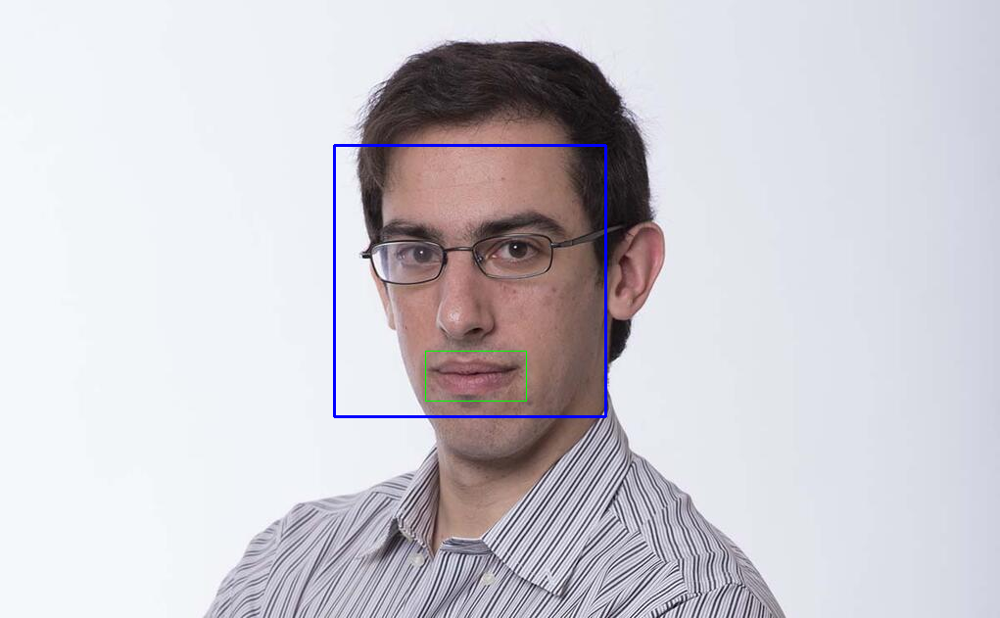

Laura Adler


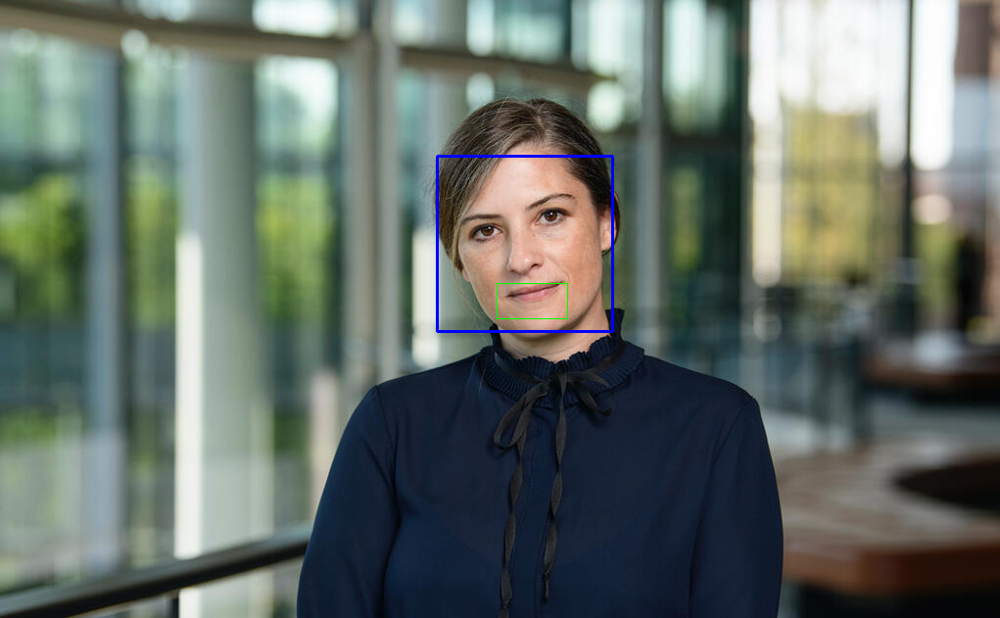

Rick Antle


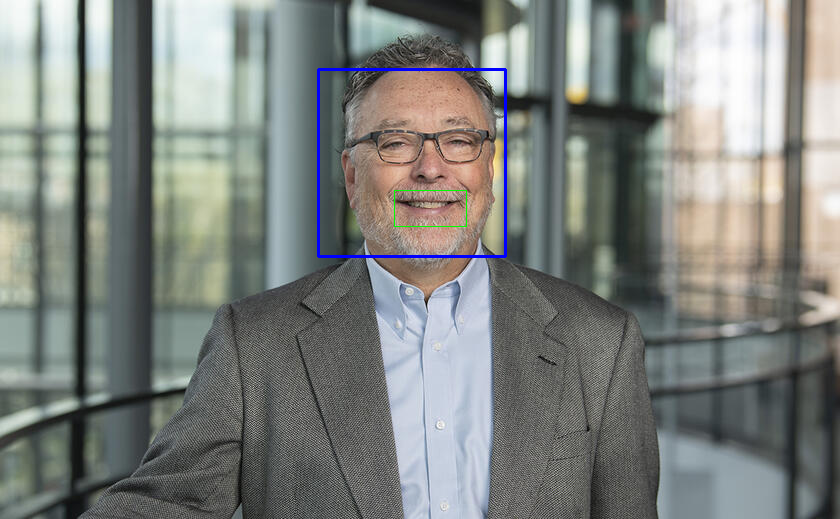

David Argente


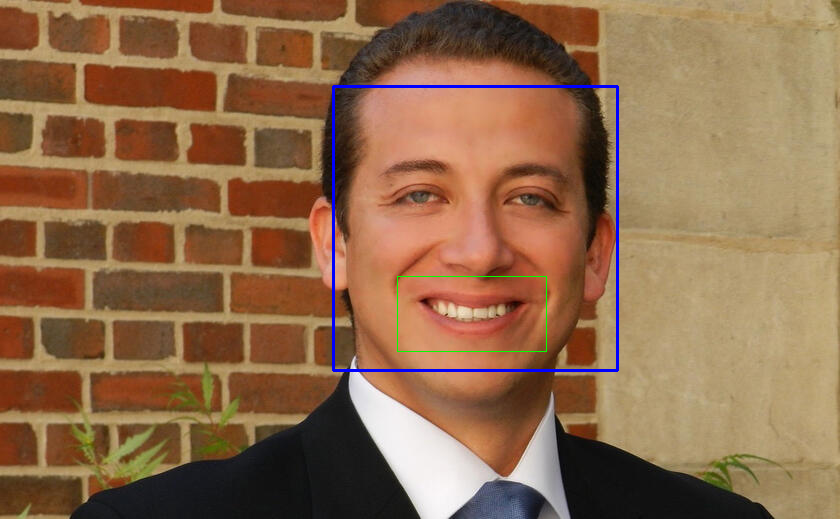

Nicholas C. Barberis


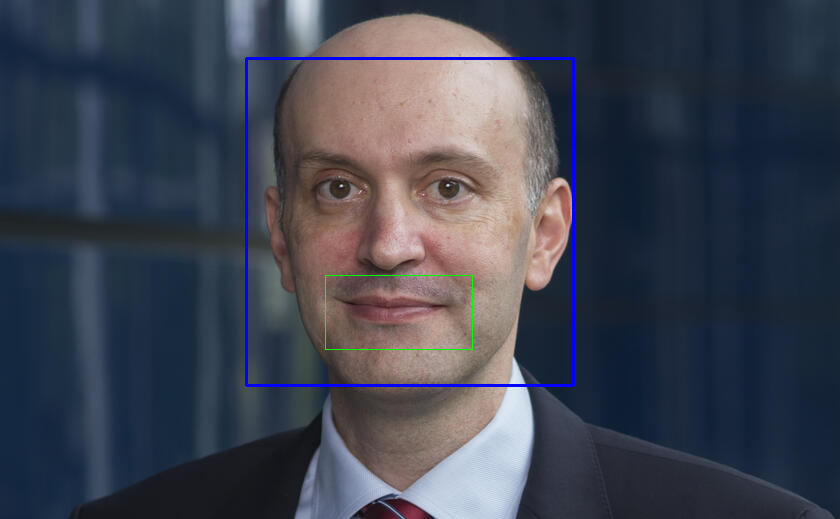

James N. Baron


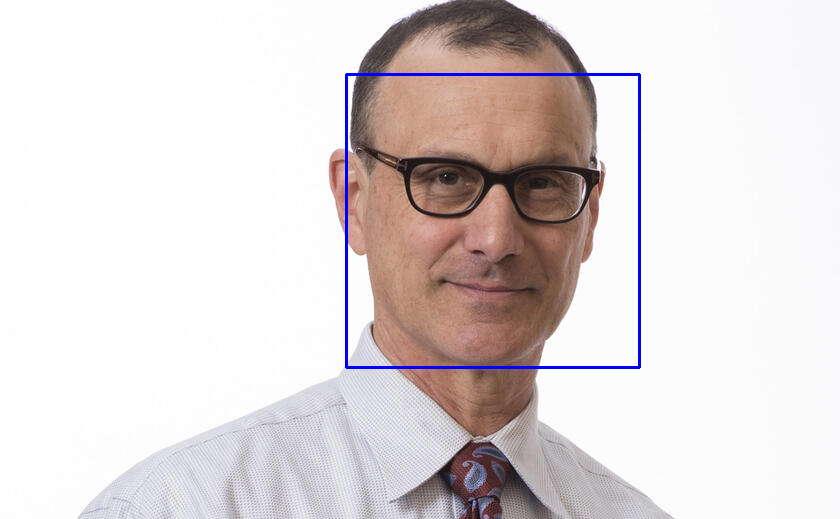

Barbara Biasi


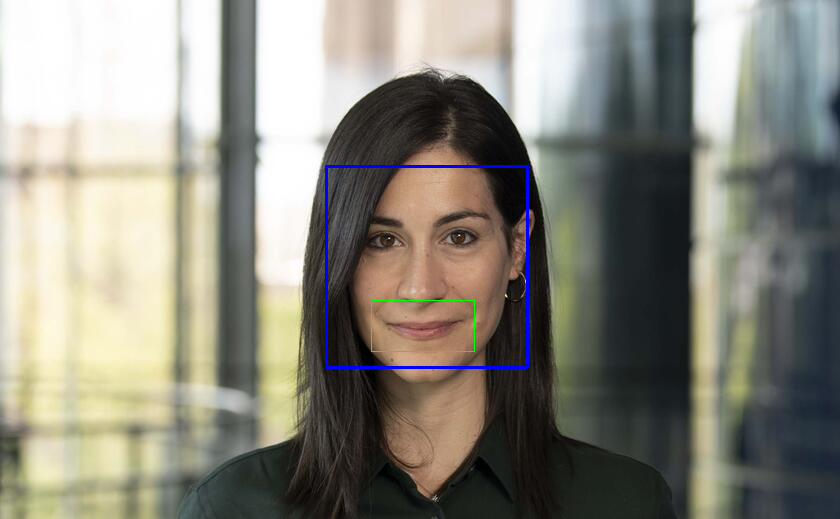

Tristan L. Botelho


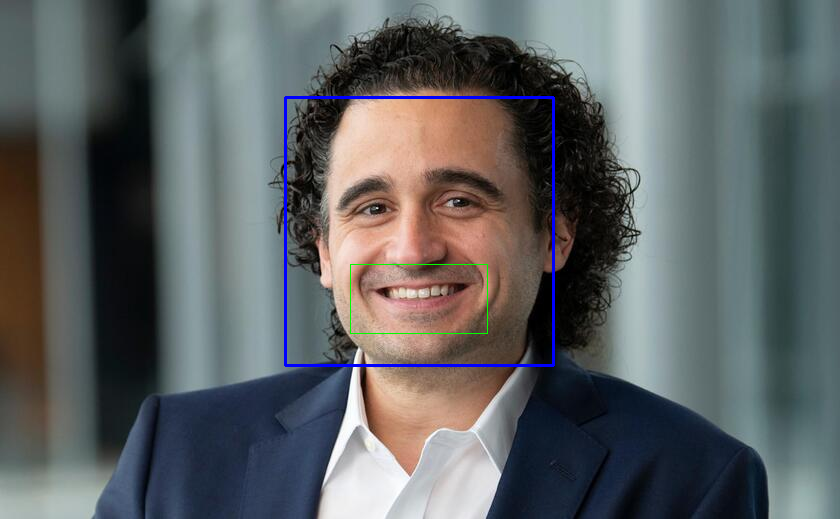

Alex Burnap


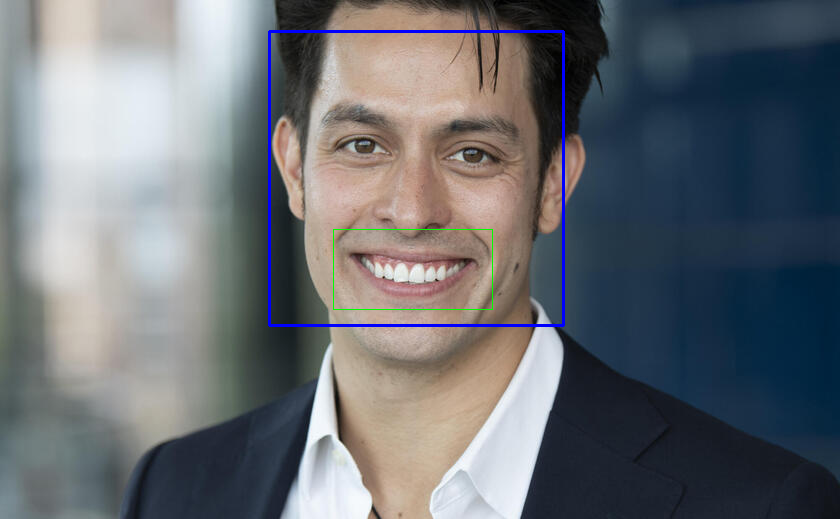

Lorenzo Caliendo


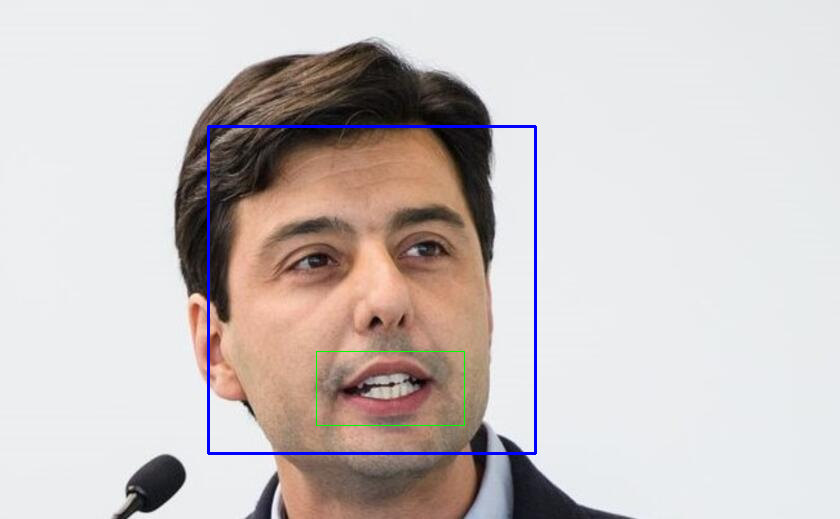

Kerwin K. Charles


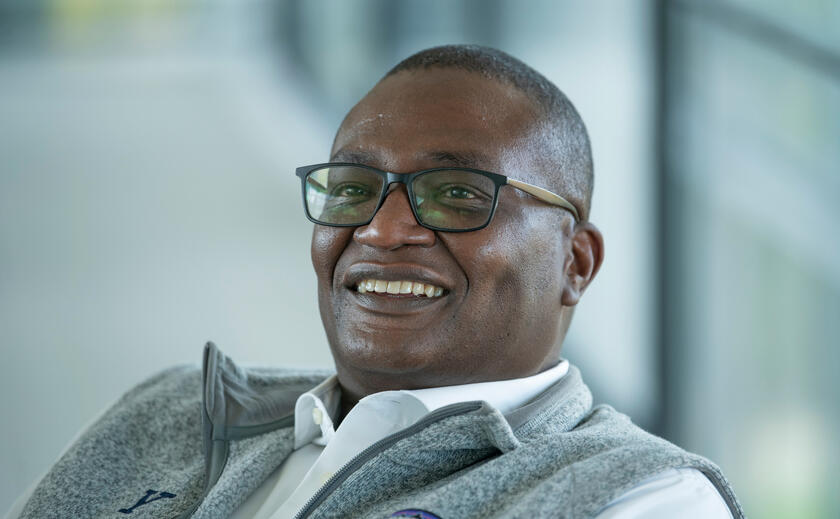

Judith A. Chevalier


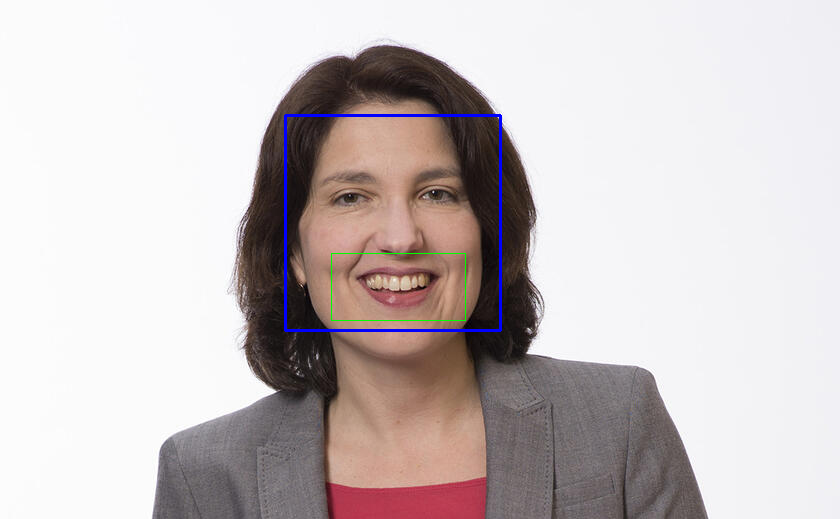

James Choi


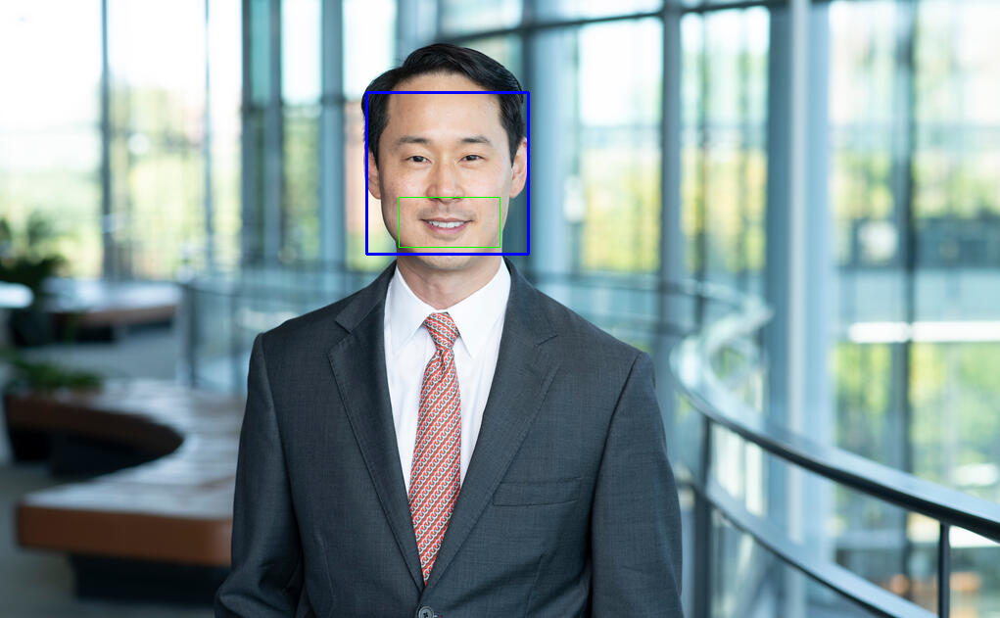

Christopher Clayton


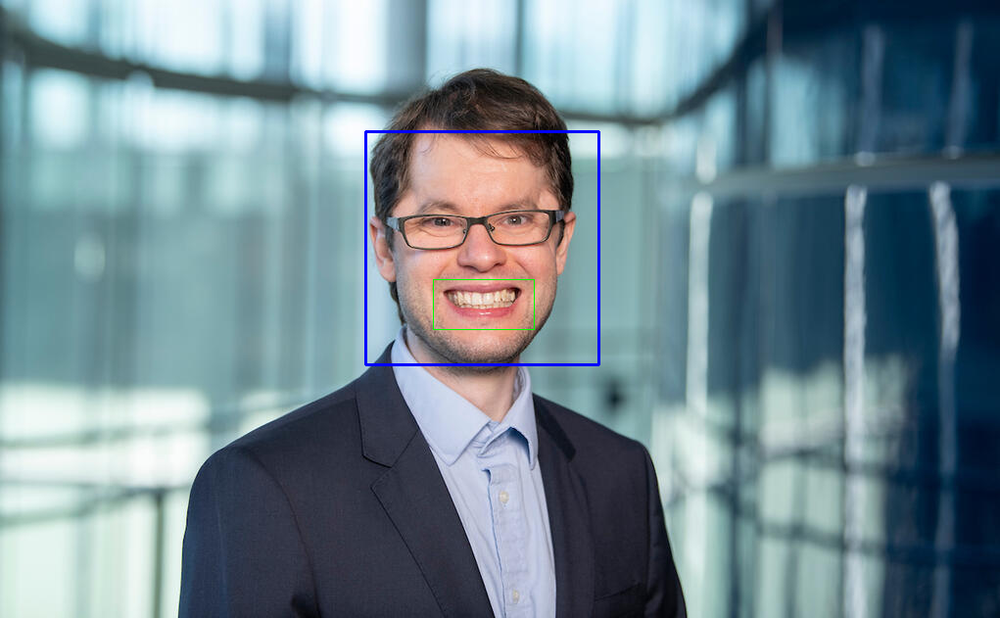

Corey Cusimano


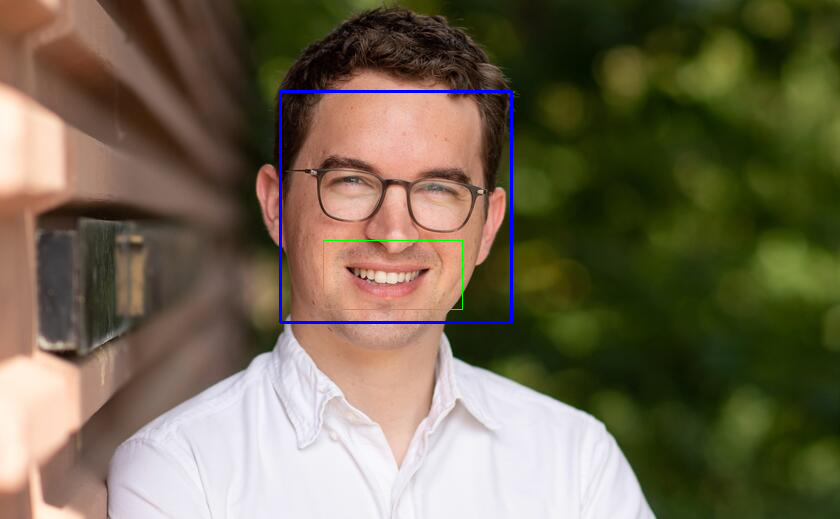

Jason Dana


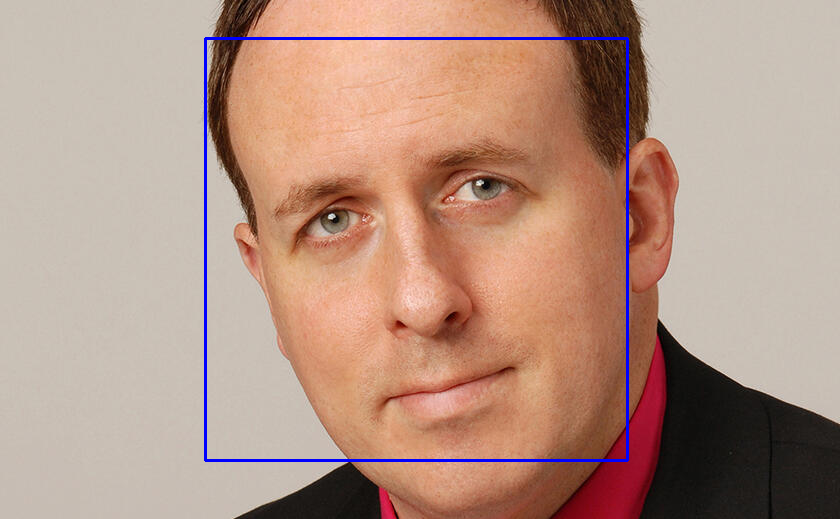

Jennifer Dannals


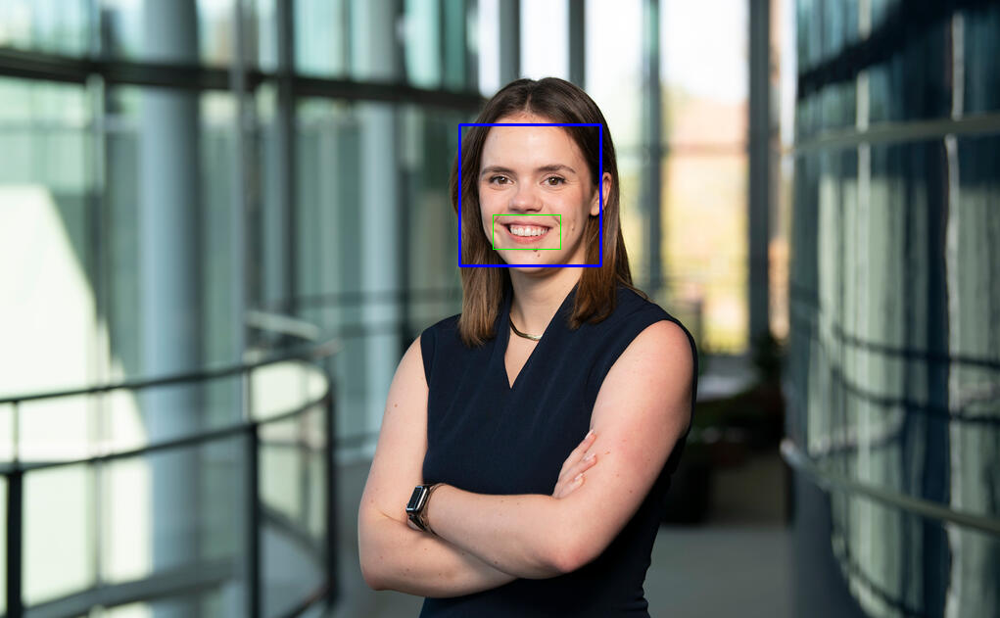

Ravi Dhar


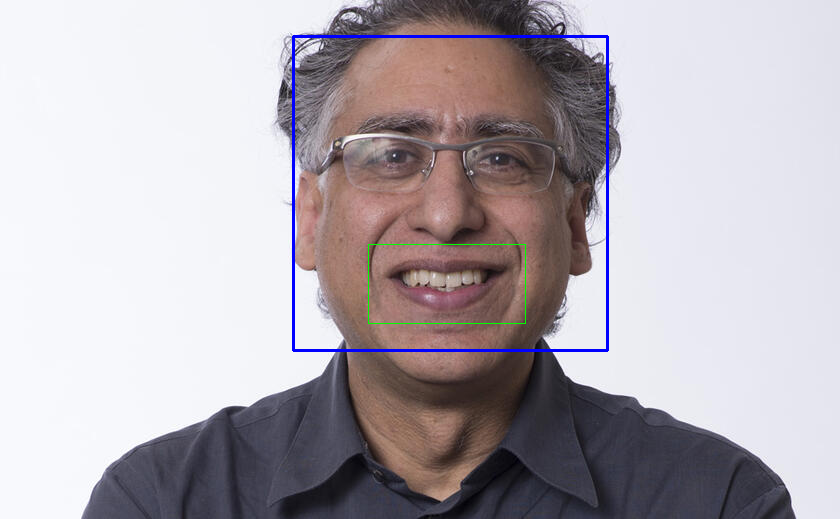

Julia DiBenigno


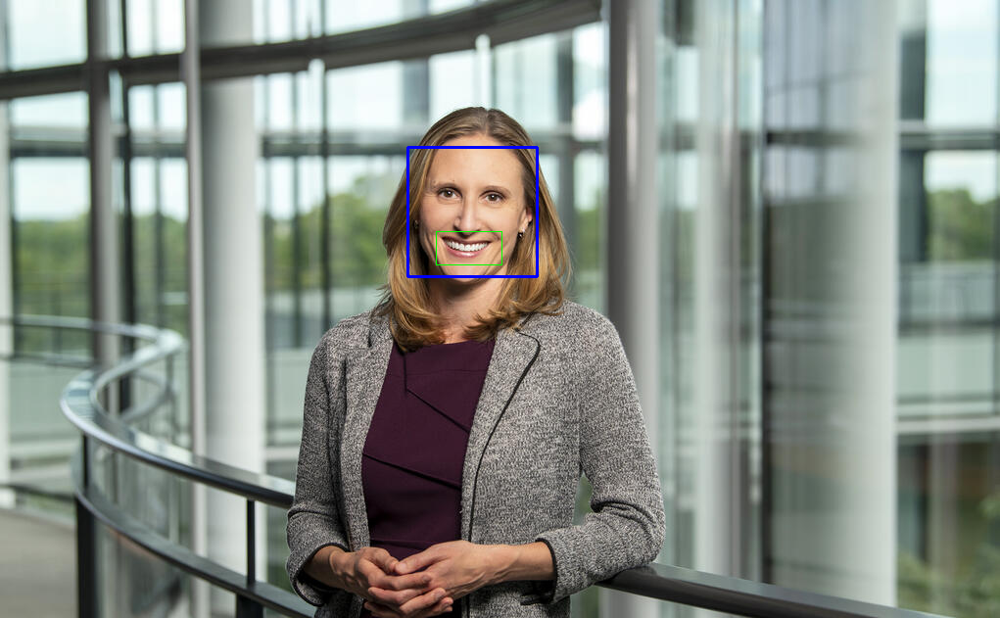

Kevin Donovan


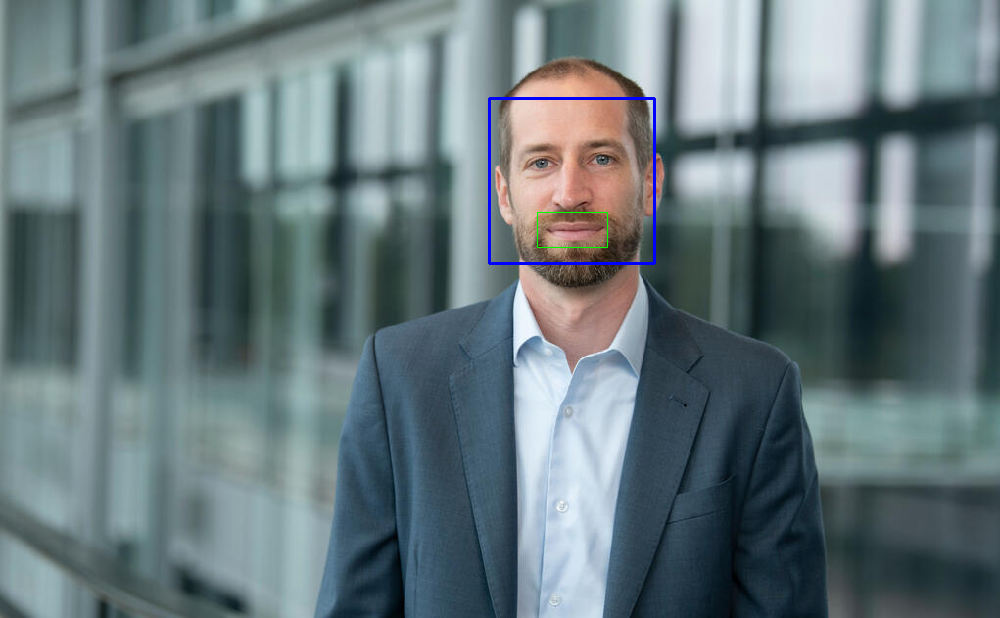

Raphael Duguay


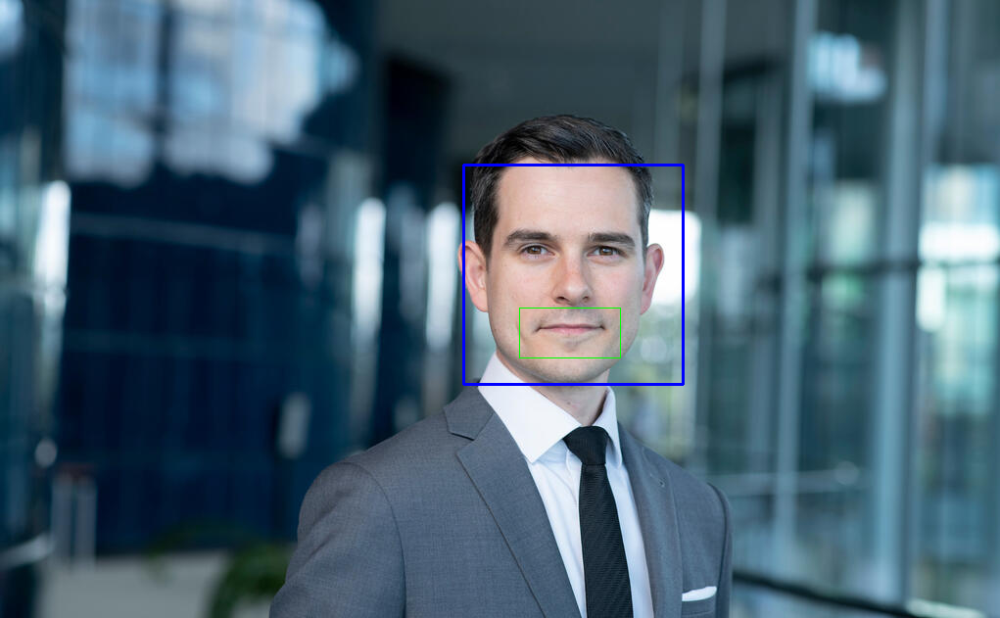

Jonathan S. Feinstein


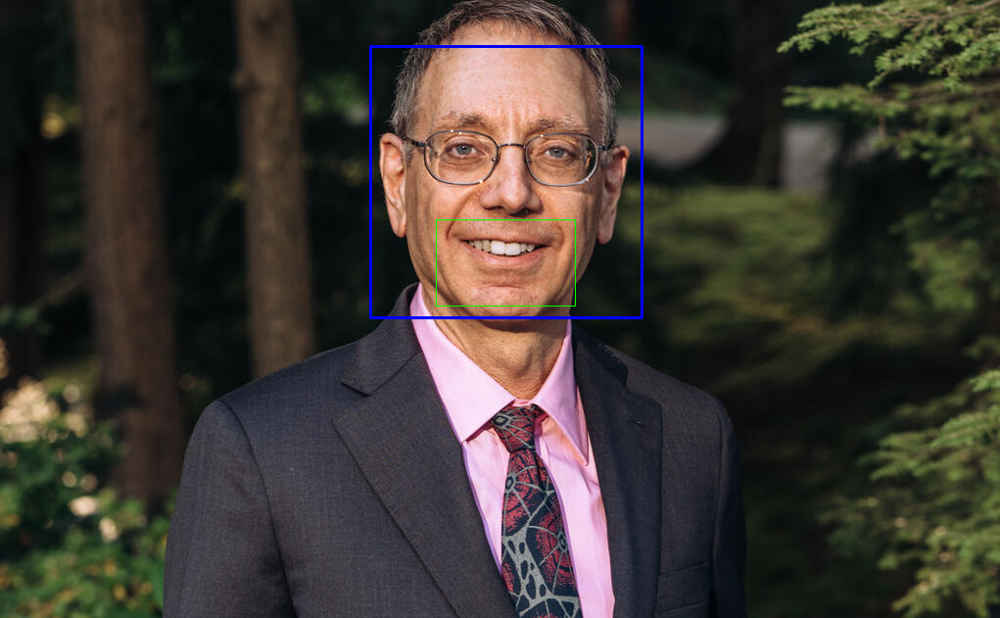

Paul Fontanier


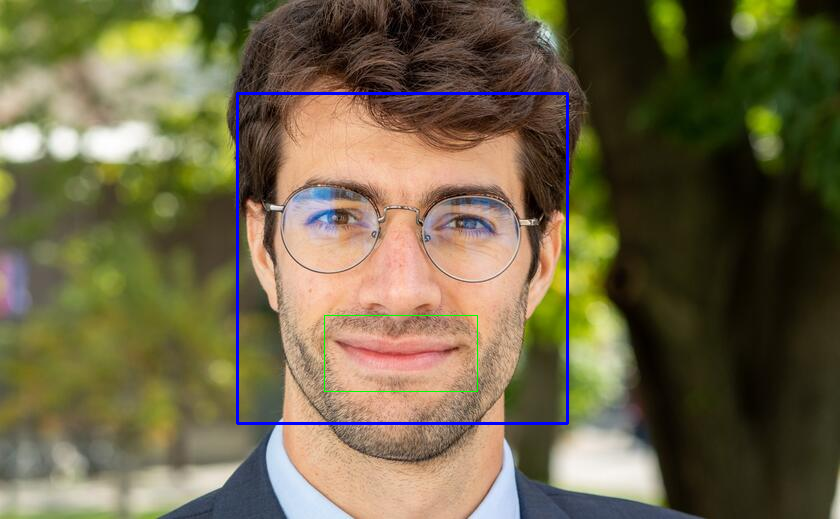

Shane Frederick


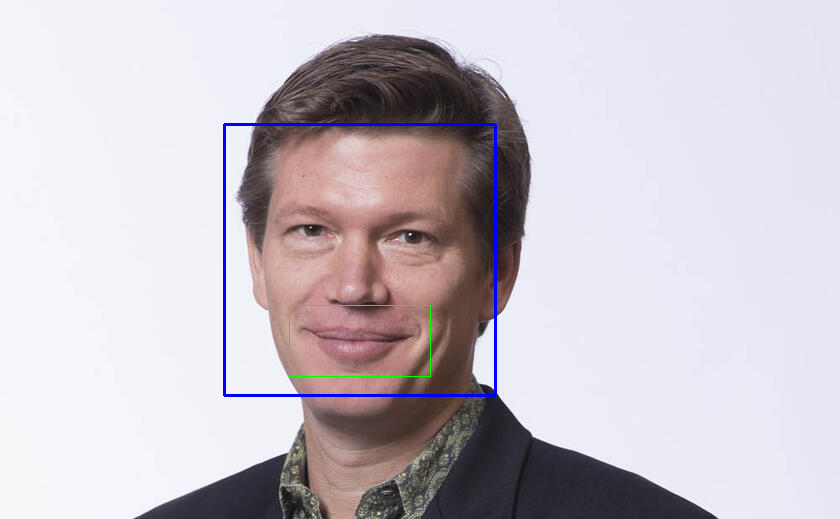

Adriana Germano


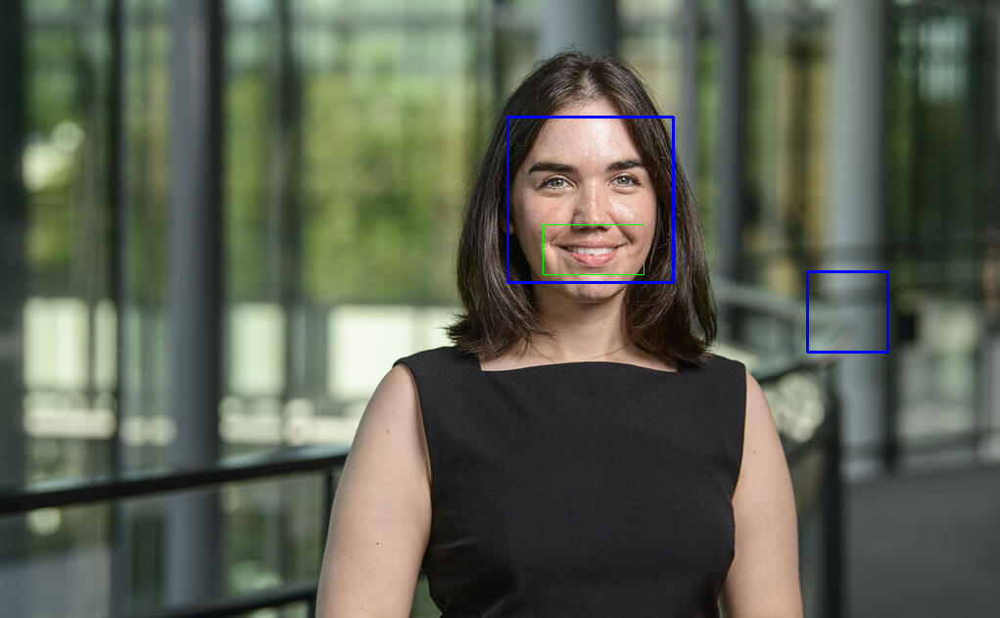

Soheil Ghili


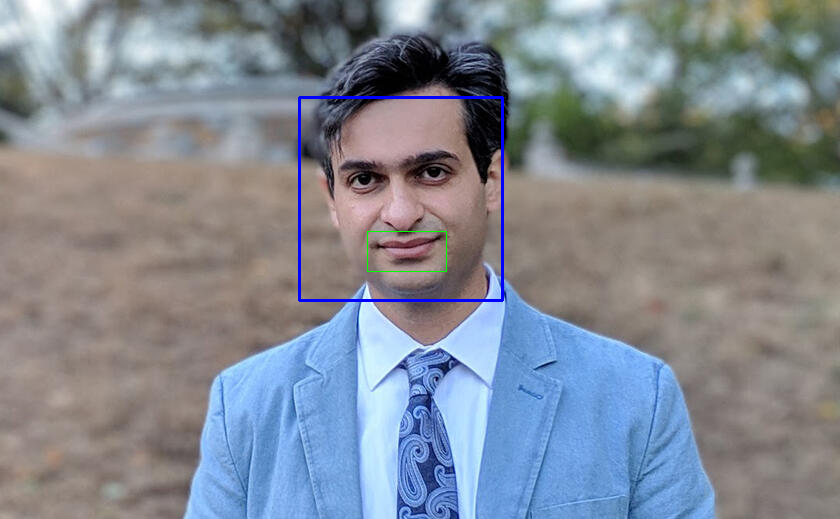

Stefano Giglio


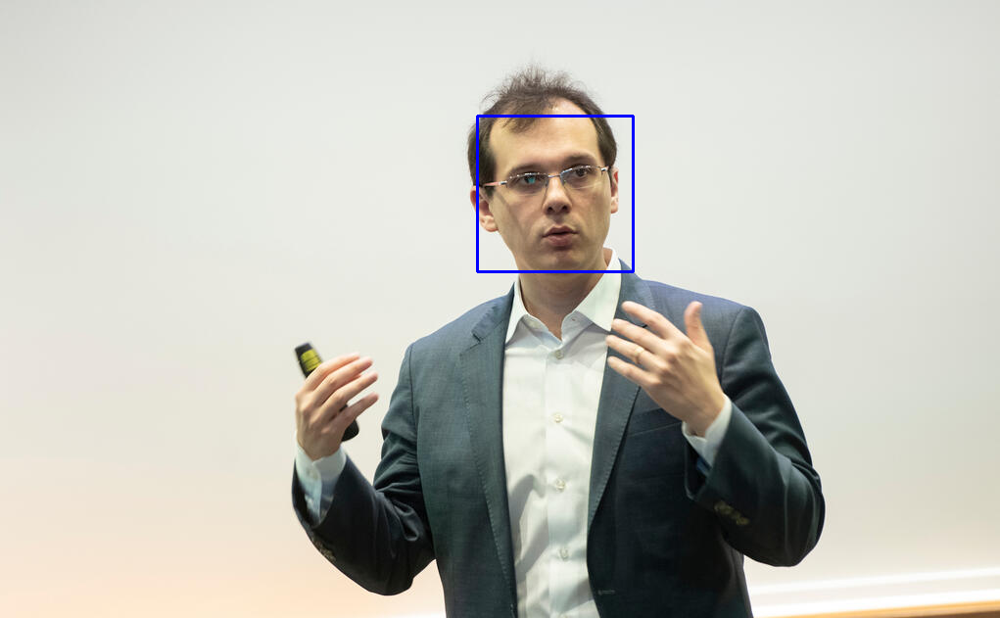

William N. Goetzmann


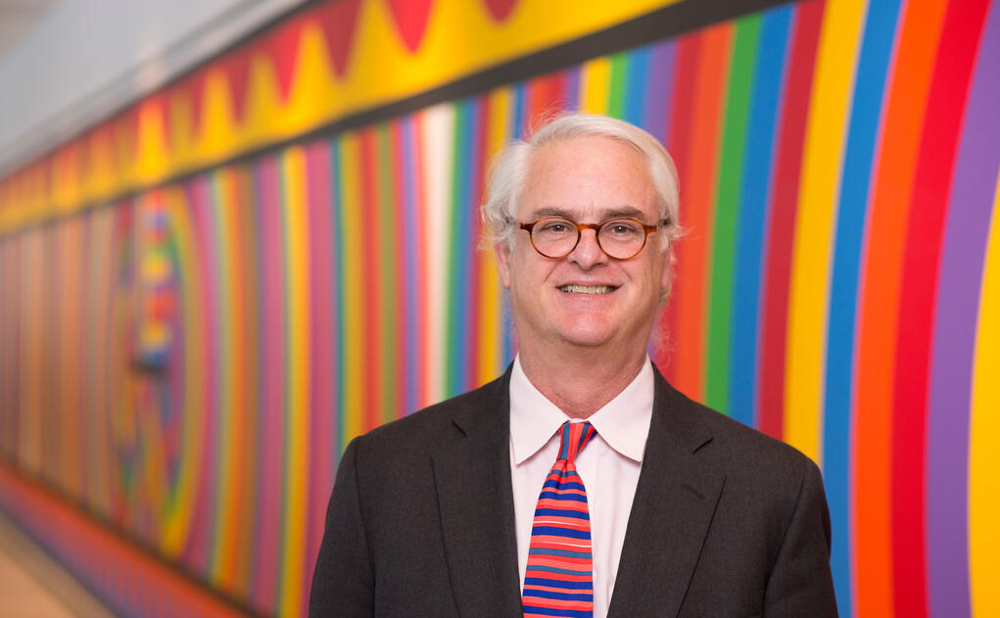

Paul Goldsmith-Pinkham


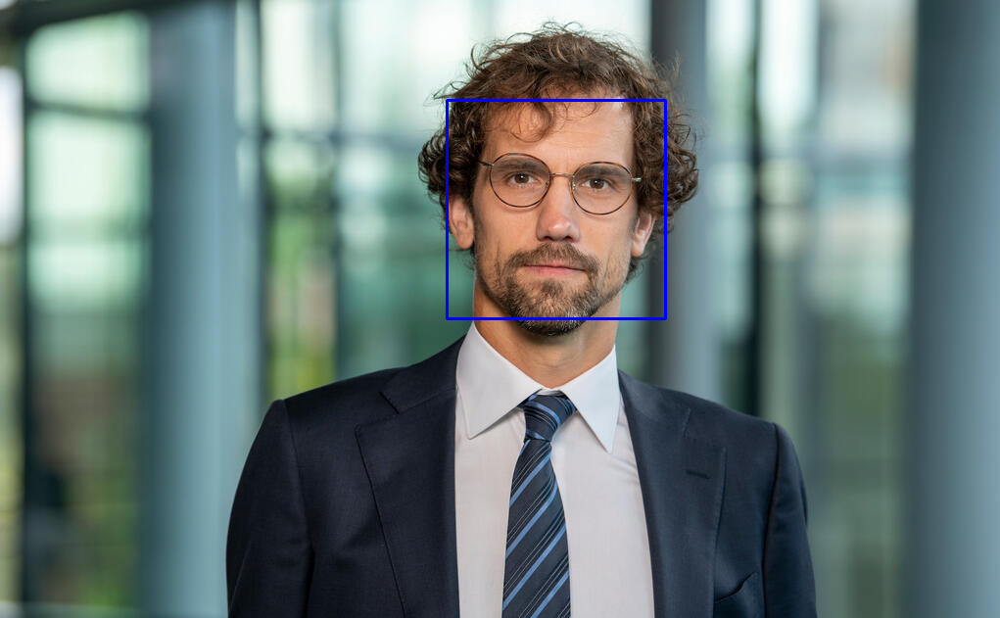

Gary B. Gorton


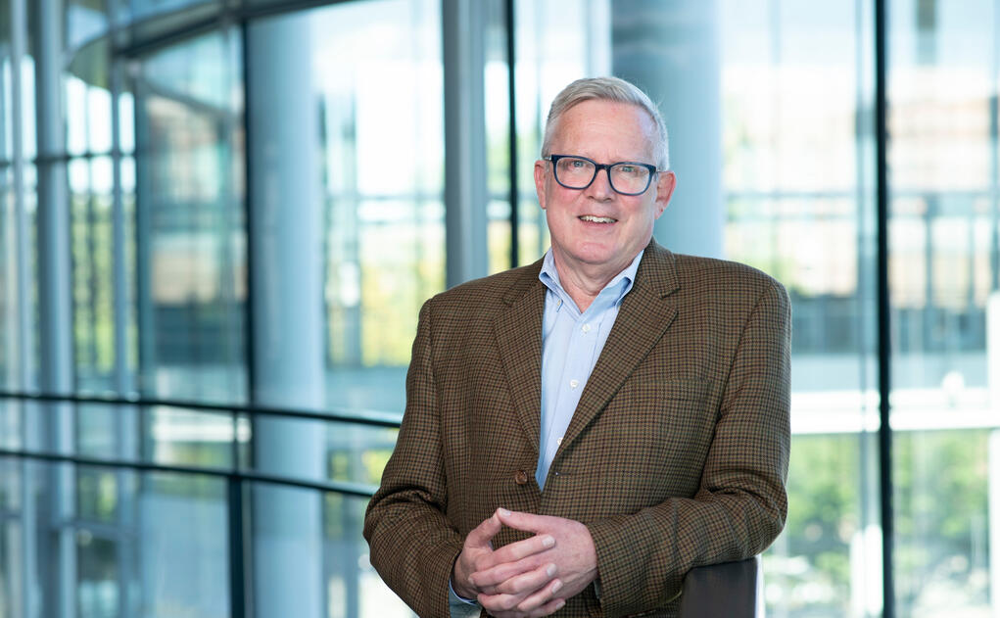

Menaka V. Hampole


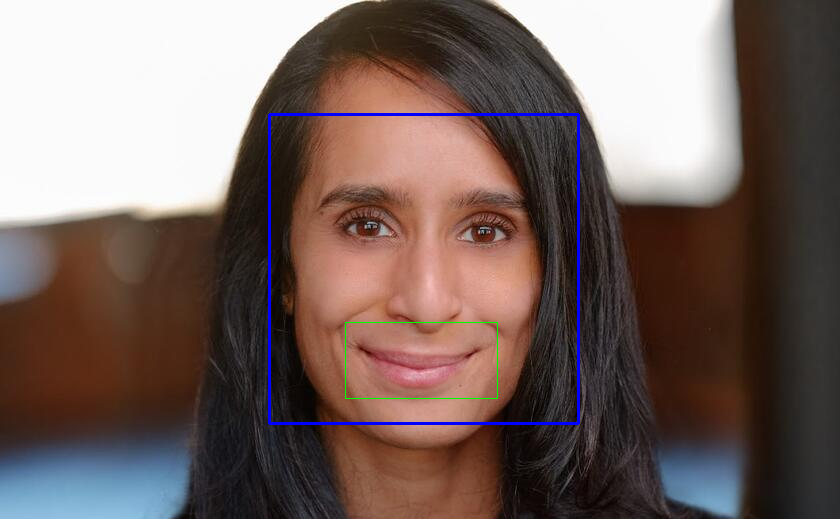

Zeqiong Huang


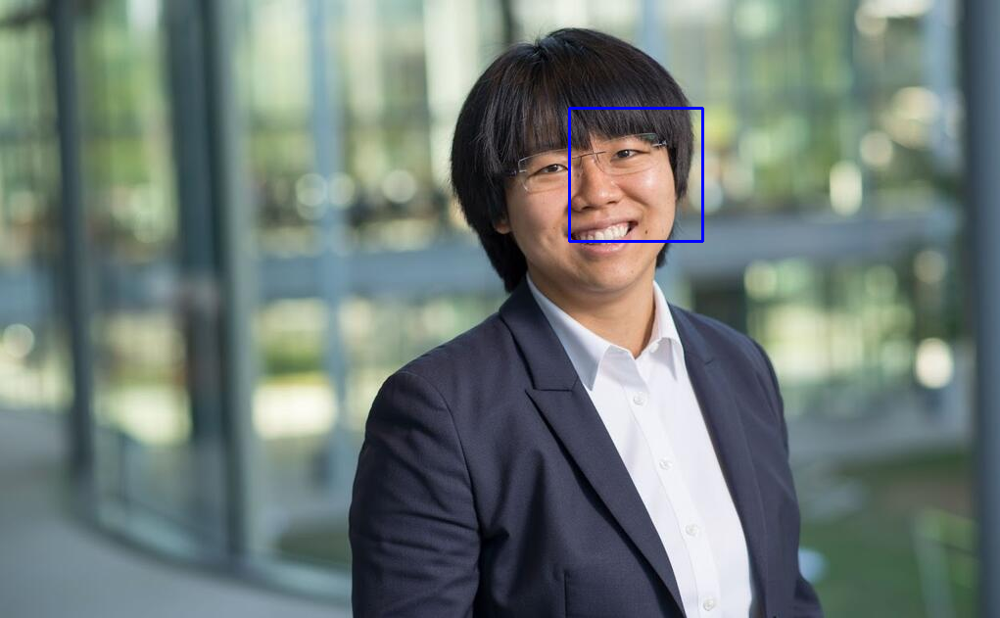

Theis Ingerslev Jensen


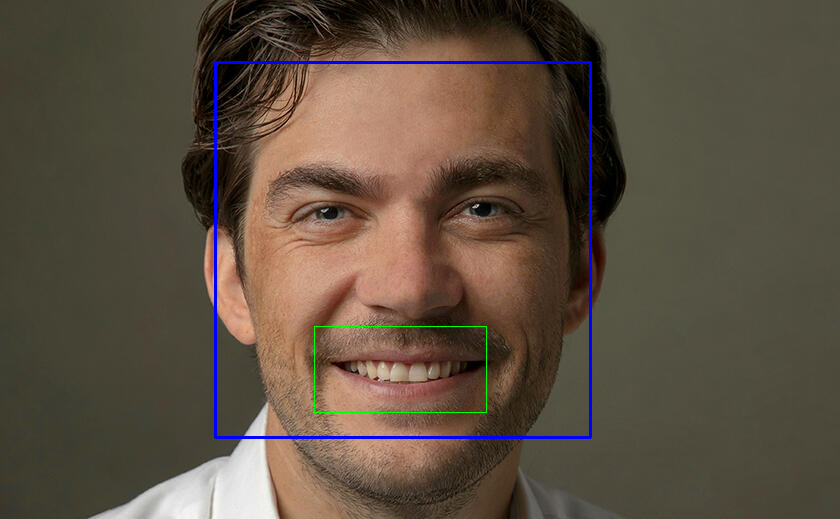

Robert T. Jensen


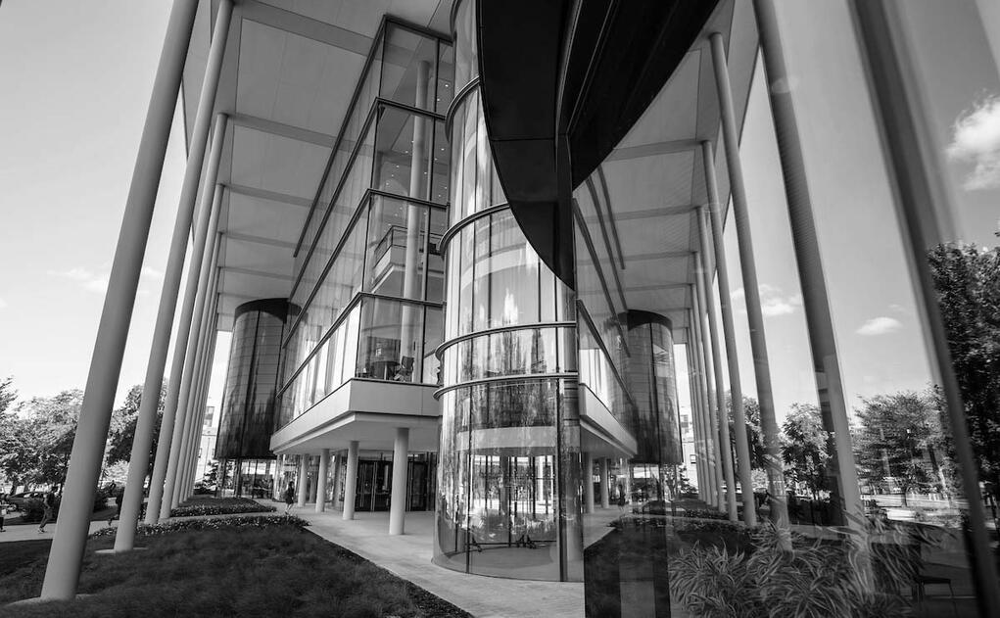

Edward H. Kaplan


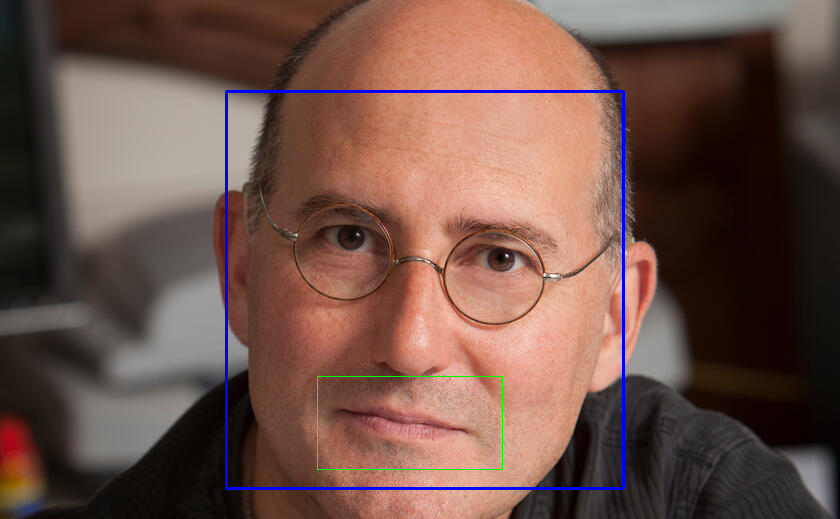

Ivana V. Katic


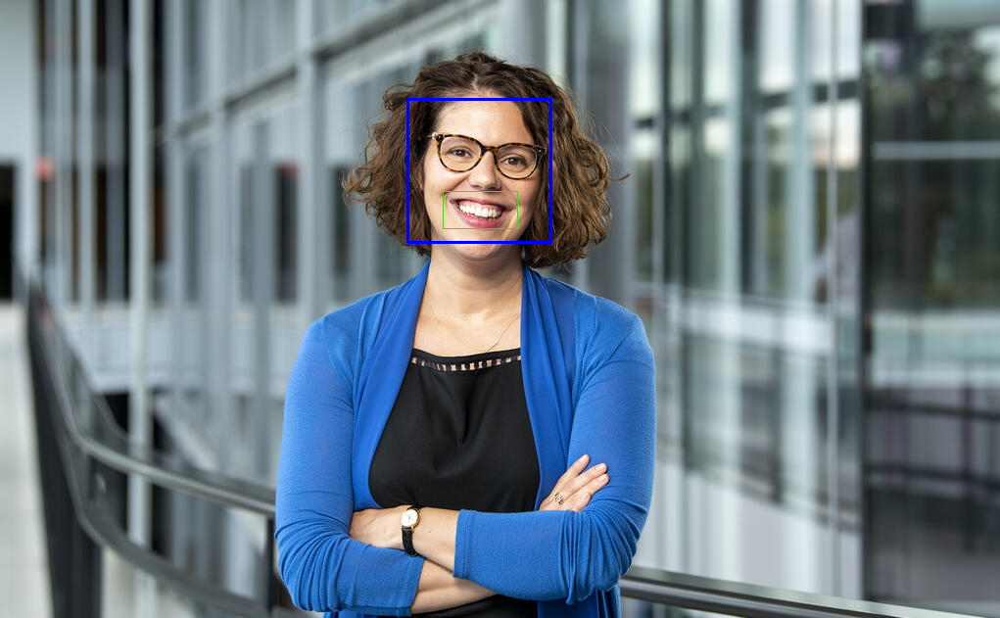

Bryan T. Kelly


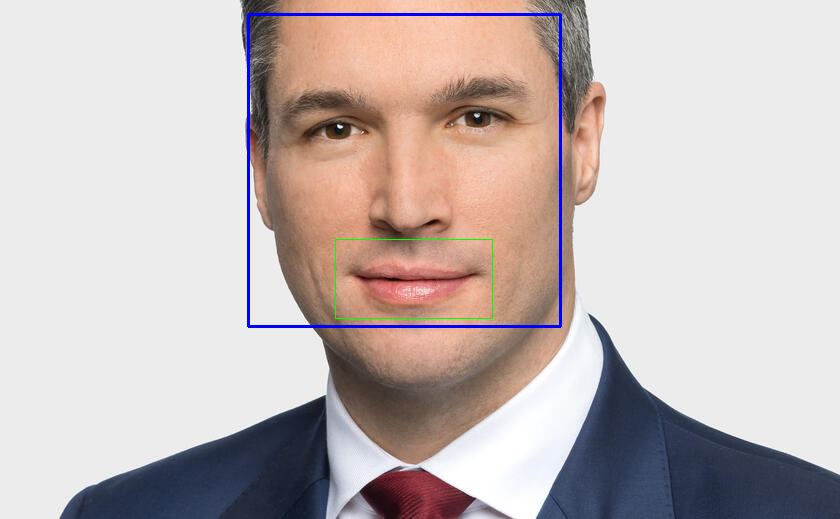

Sang Kim


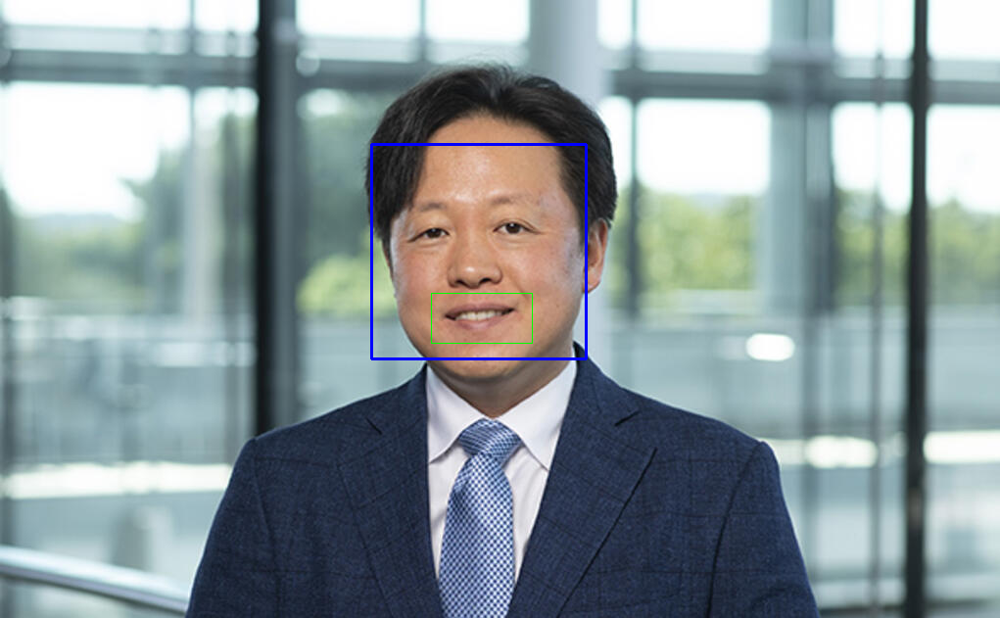

Balázs Kovács


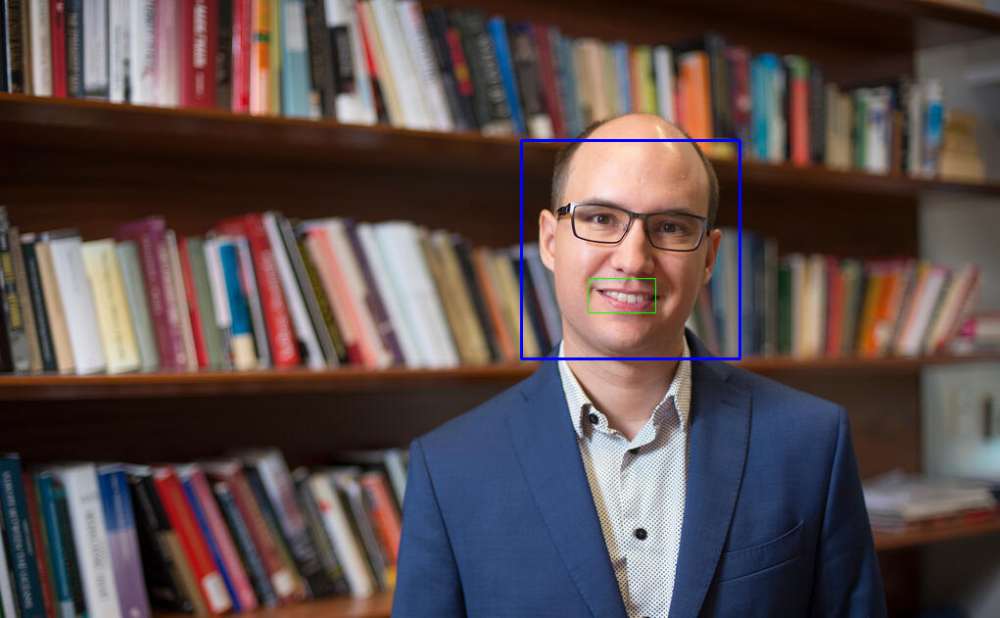

Vineet Kumar


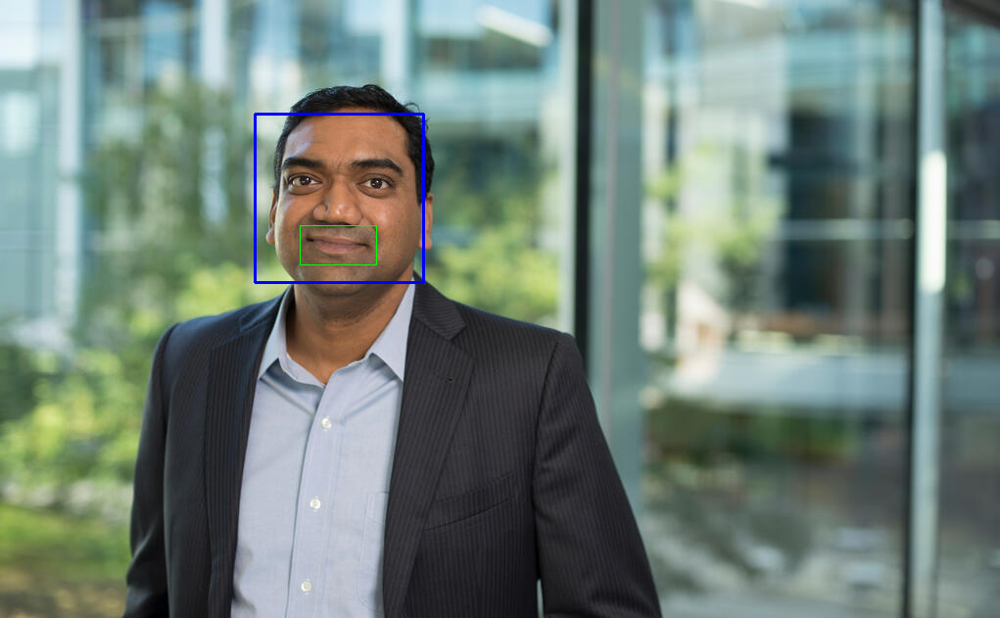

Cameron LaPoint


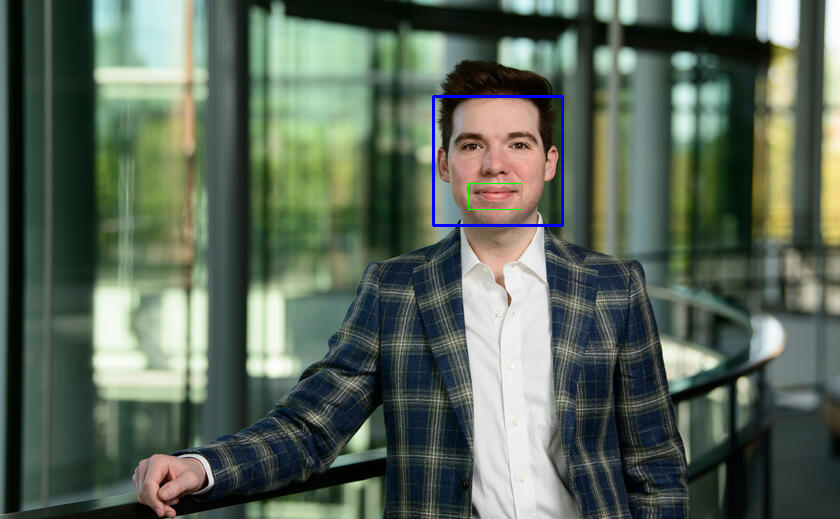

James A. Levinsohn


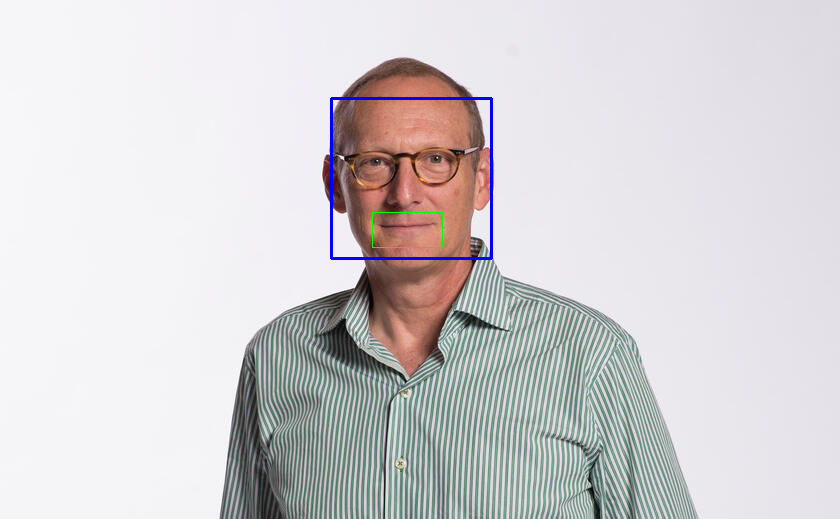

Zhen Lian


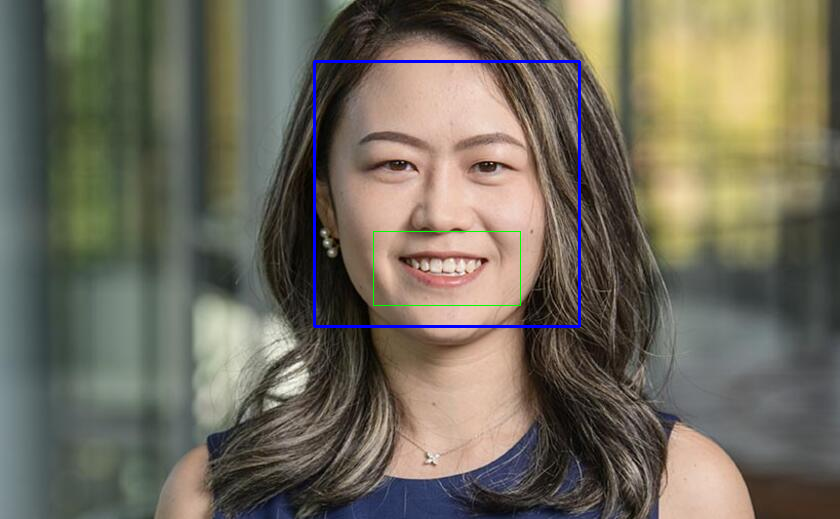

Song Ma


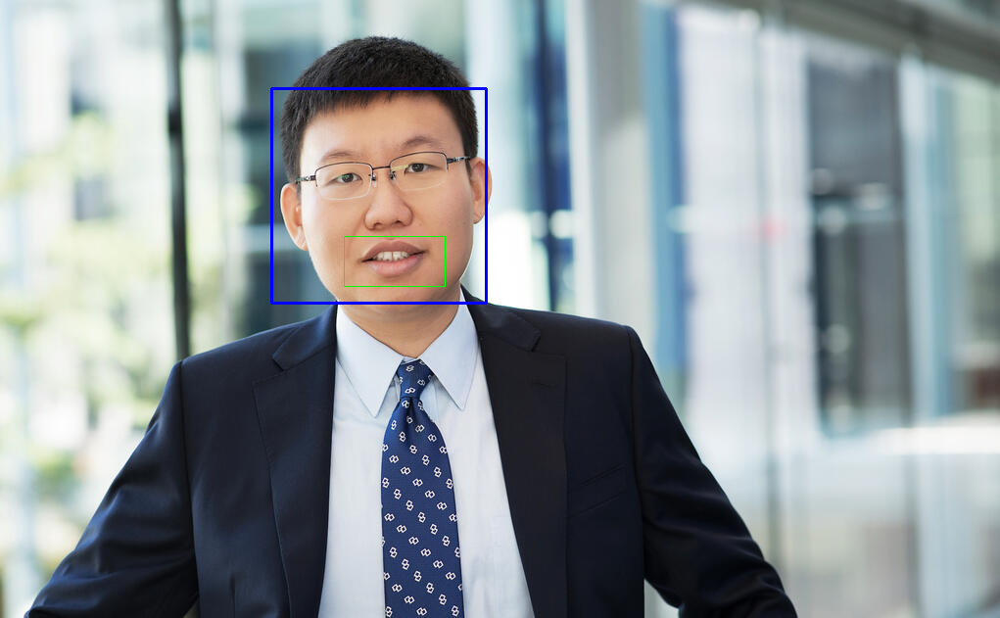

Vahideh Manshadi


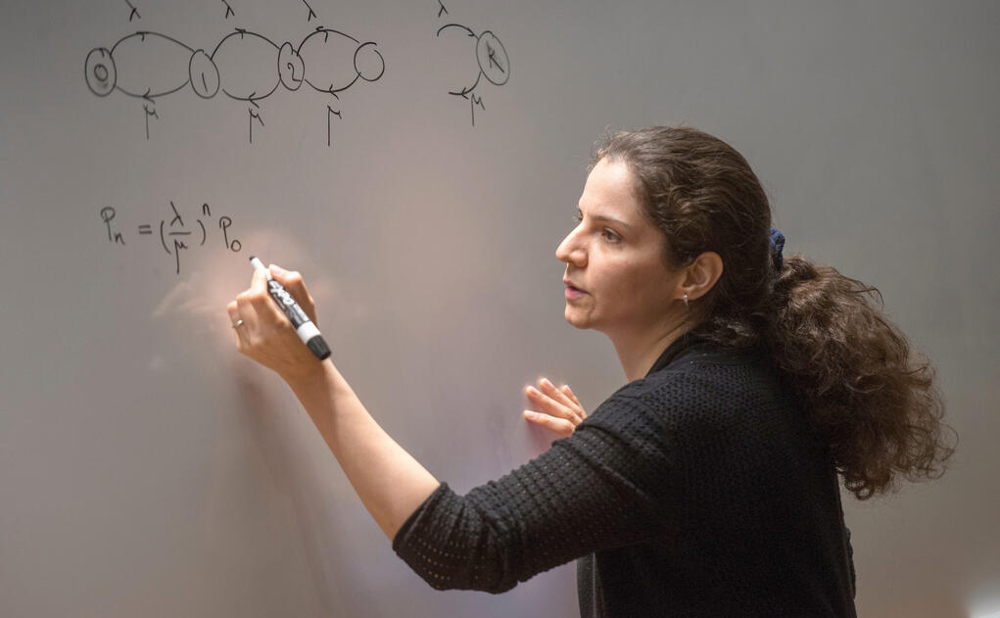

Lesley Meng


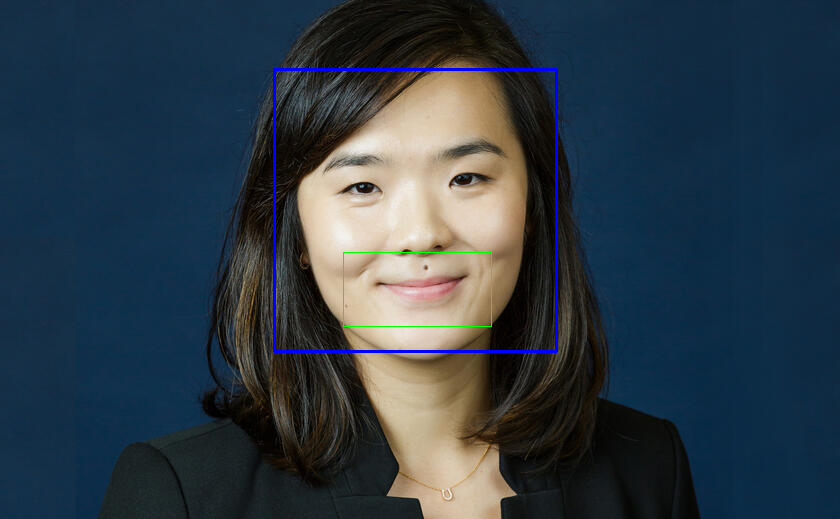

Andrew Metrick


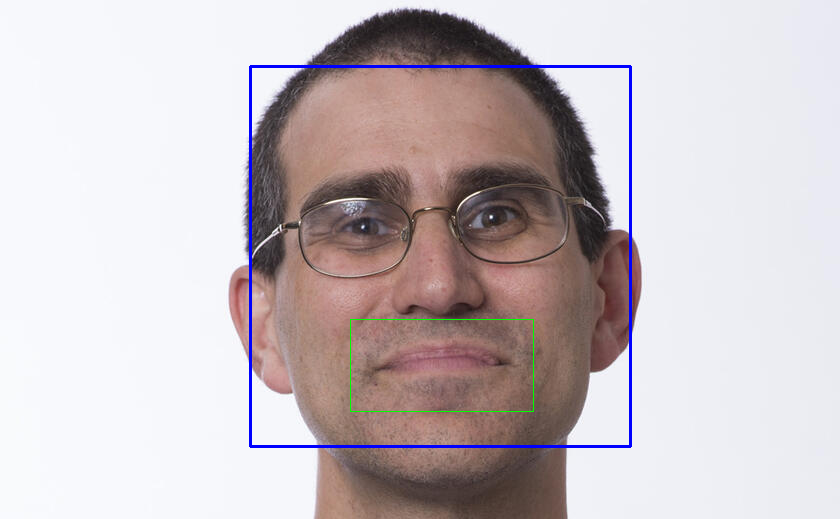

Ahmed Mushfiq Mobarak


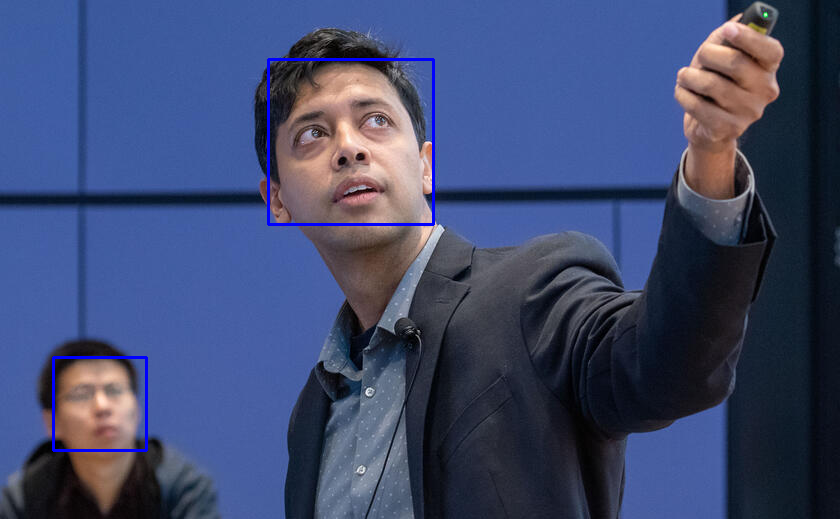

Faidra Monachou


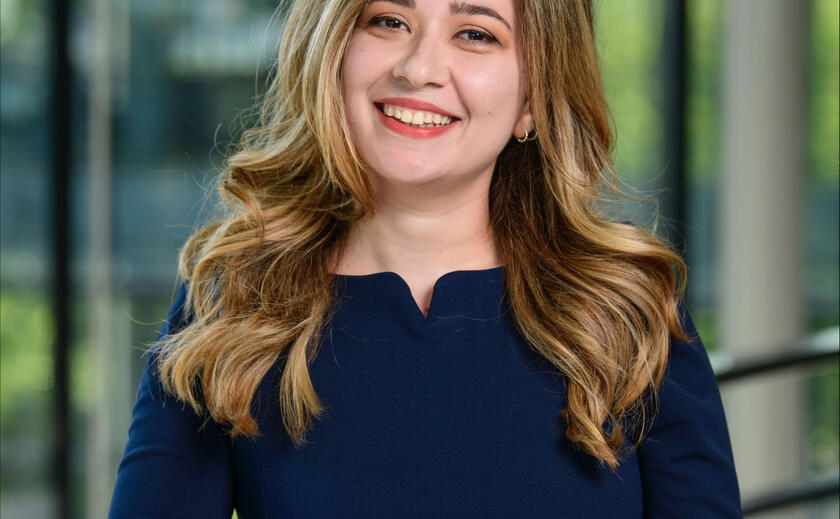

Tobias J. Moskowitz


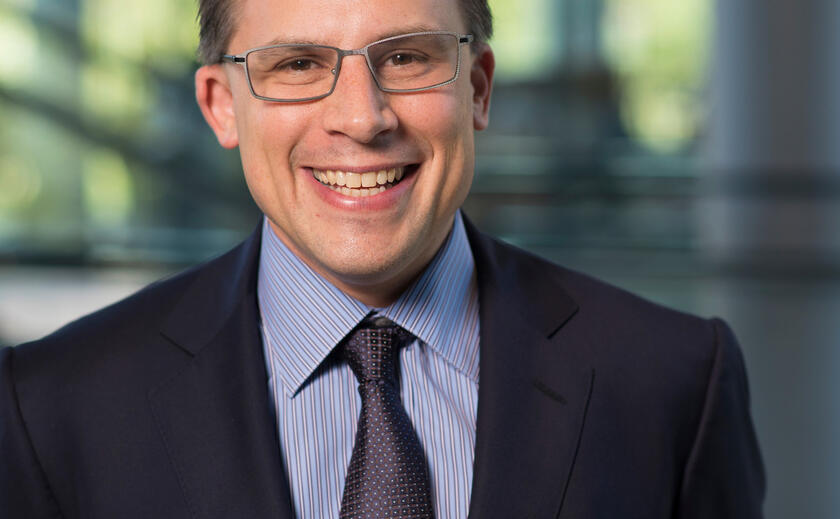

David M. Munguia Gomez


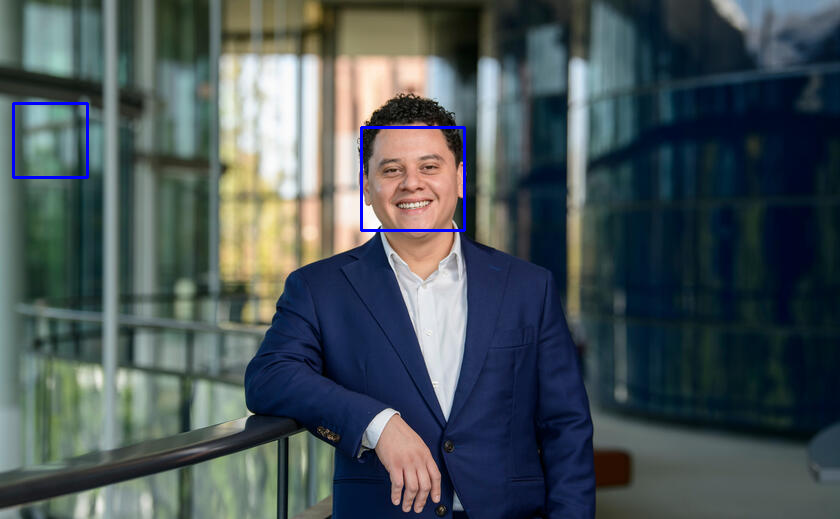

Anya Nakhmurina


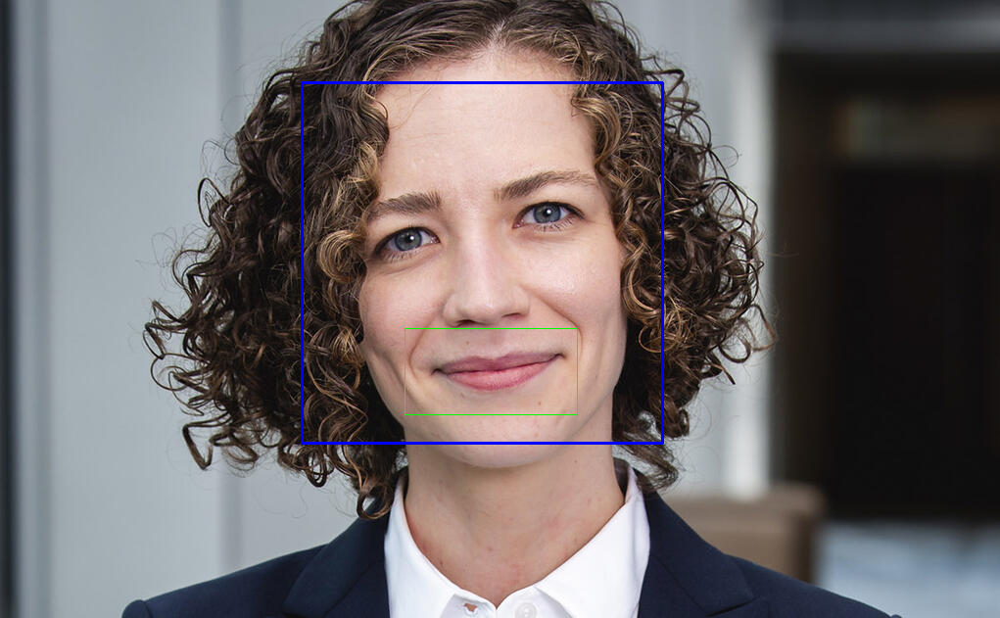

Barry Nalebuff


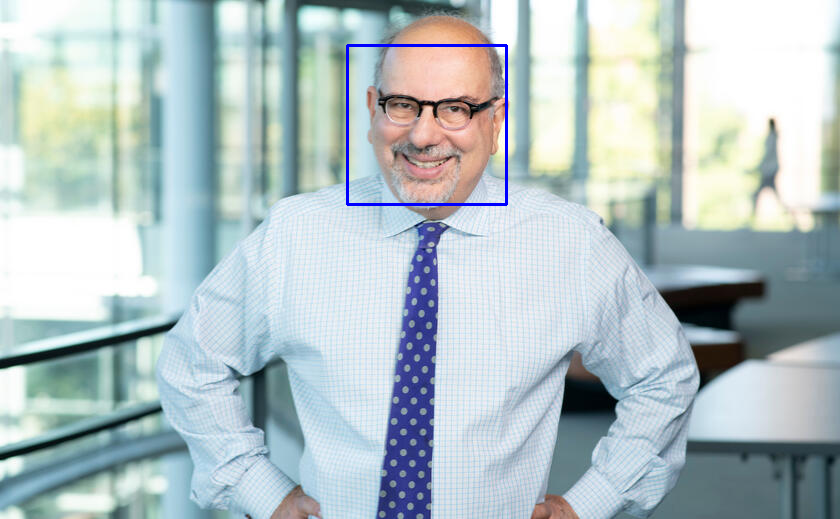

Nathan Novemsky


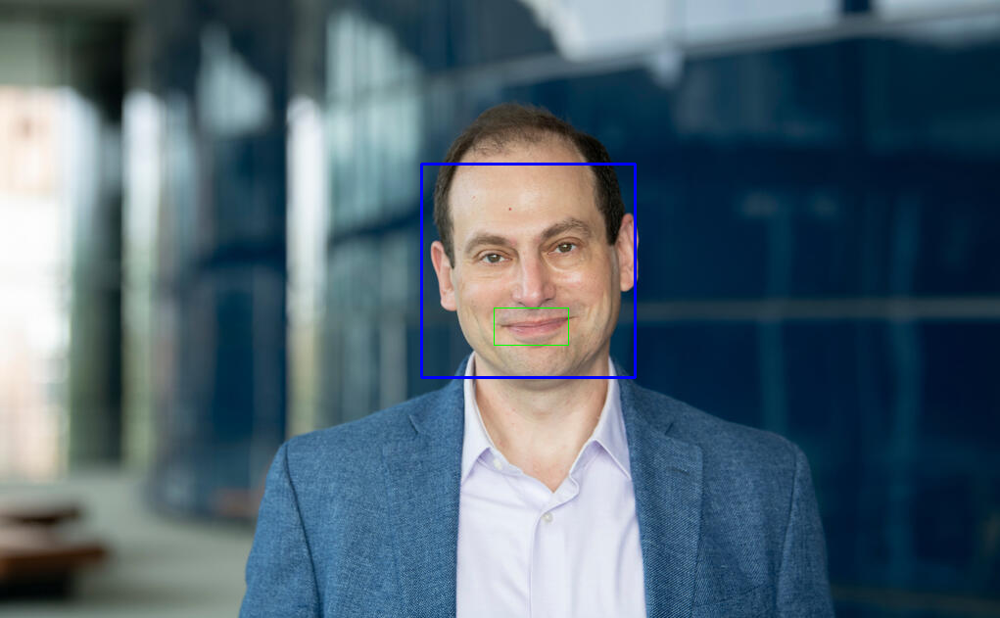

Jayanti Owens


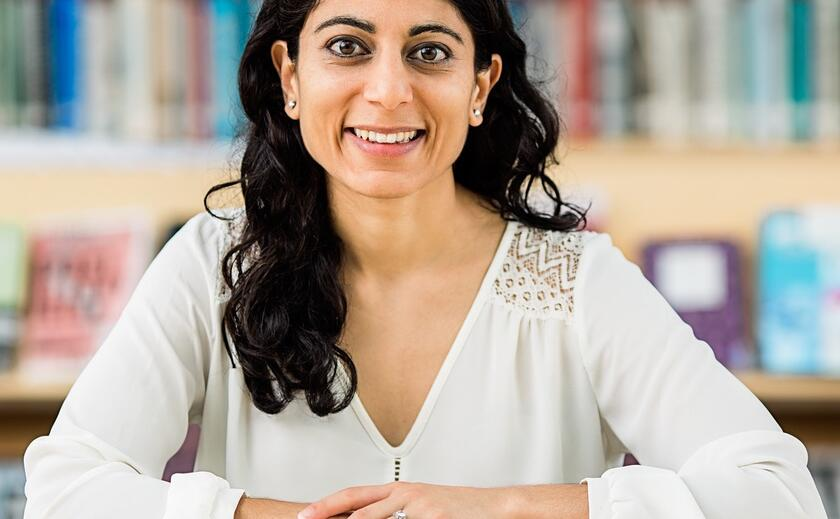

Edieal J. Pinker


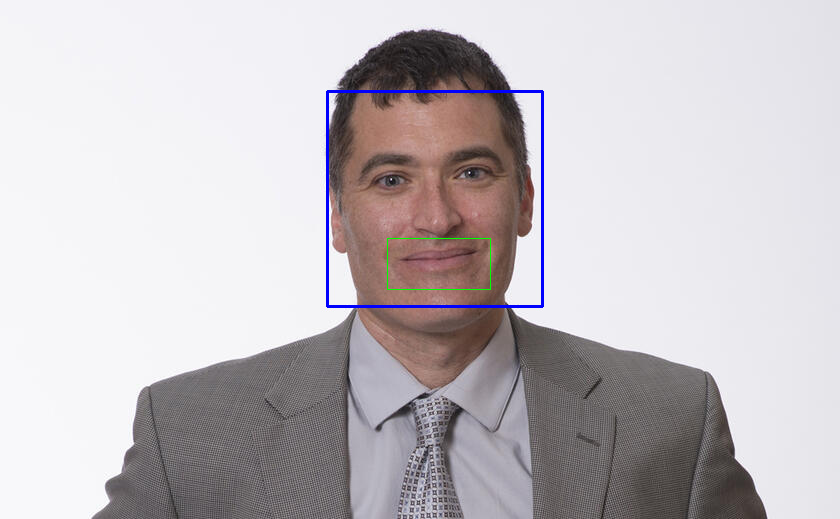

Benjamin Polak


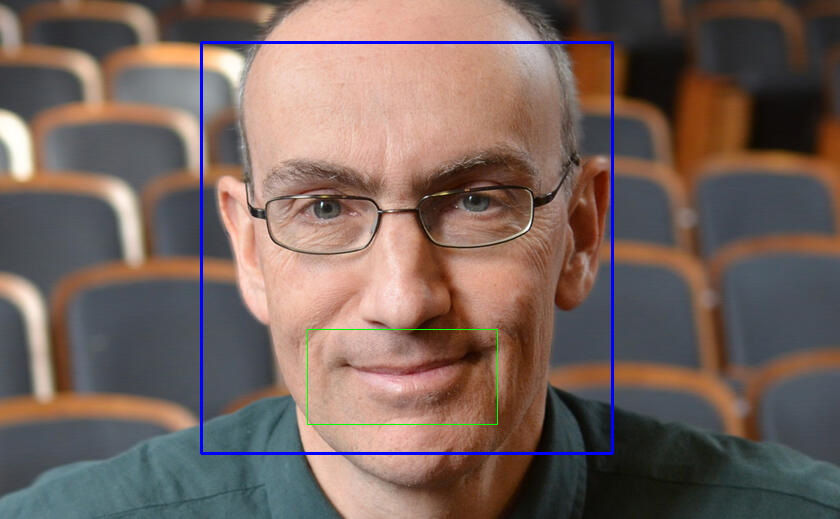

Taly Reich


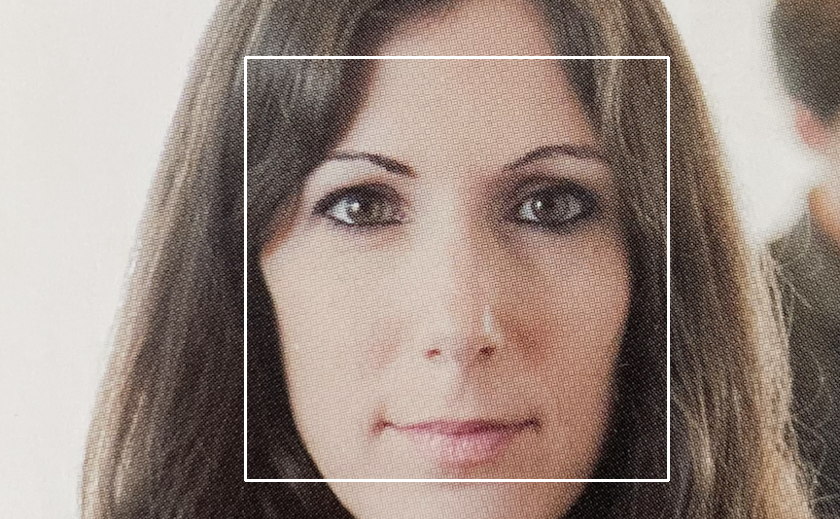

K. Geert Rouwenhorst


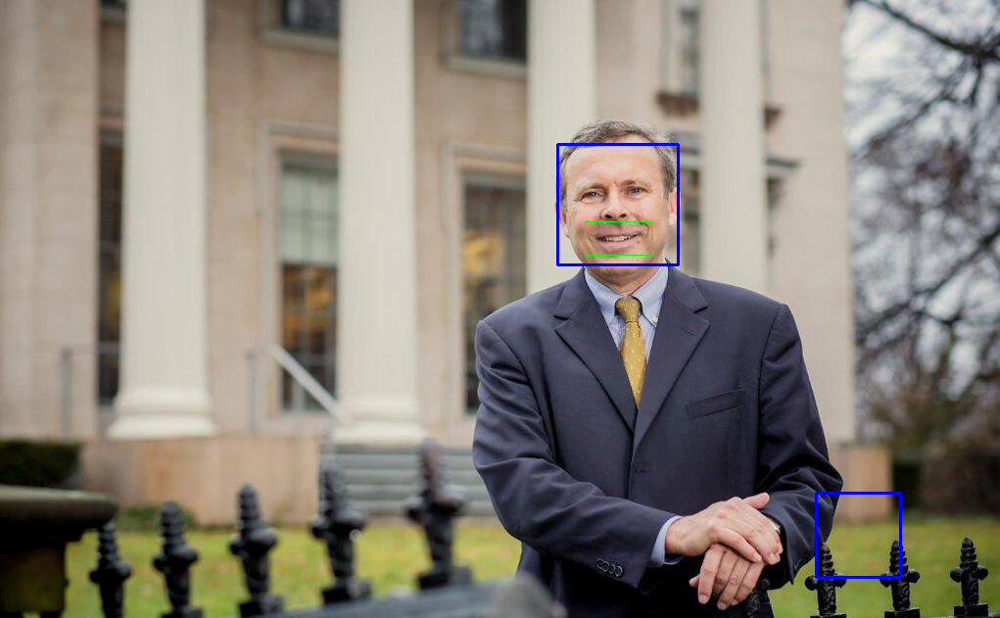

Nils Rudi


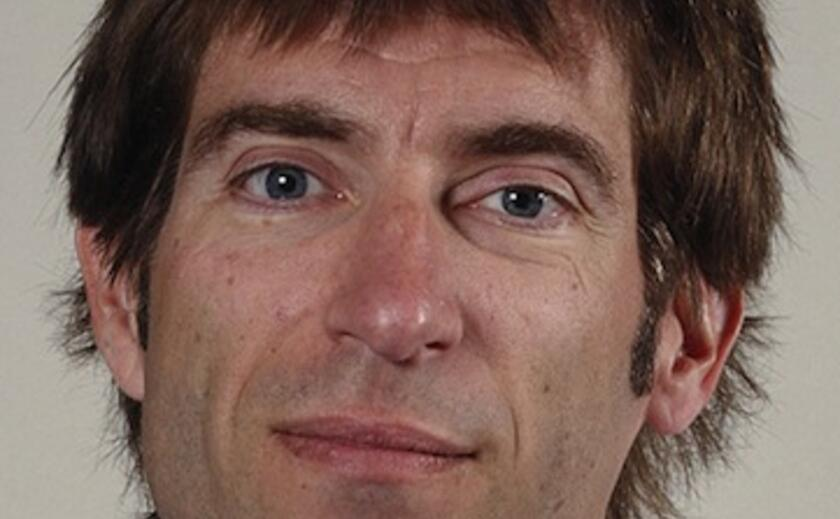

Peter K. Schott


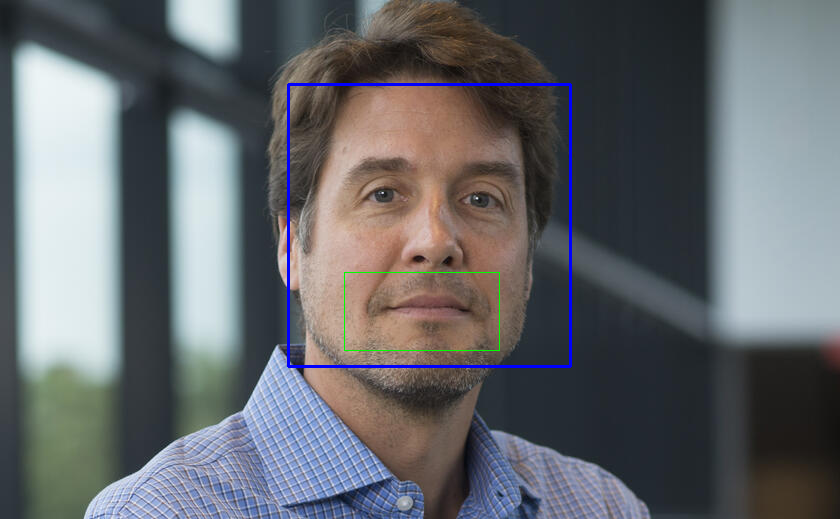

Fiona M. Scott Morton


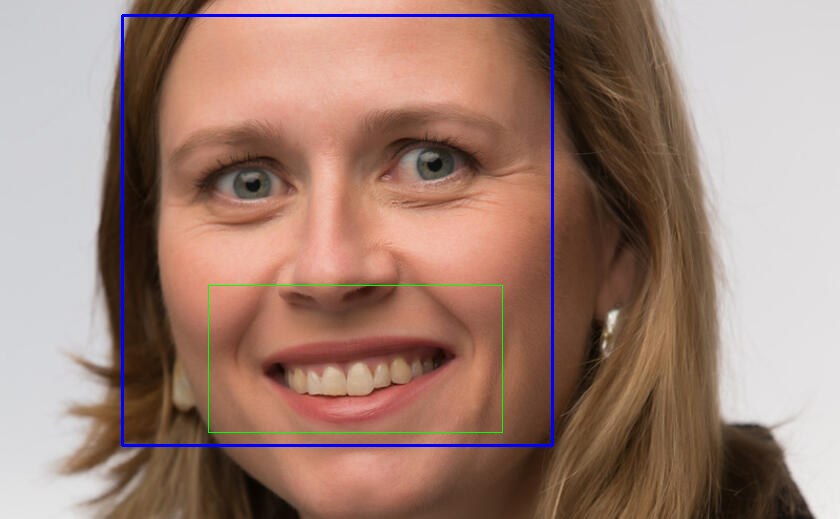

Katja Seim


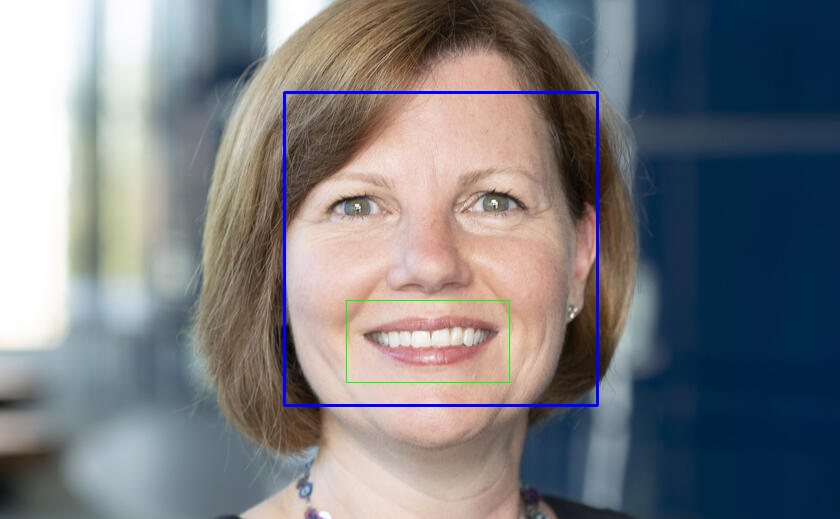

Jiwoong Shin


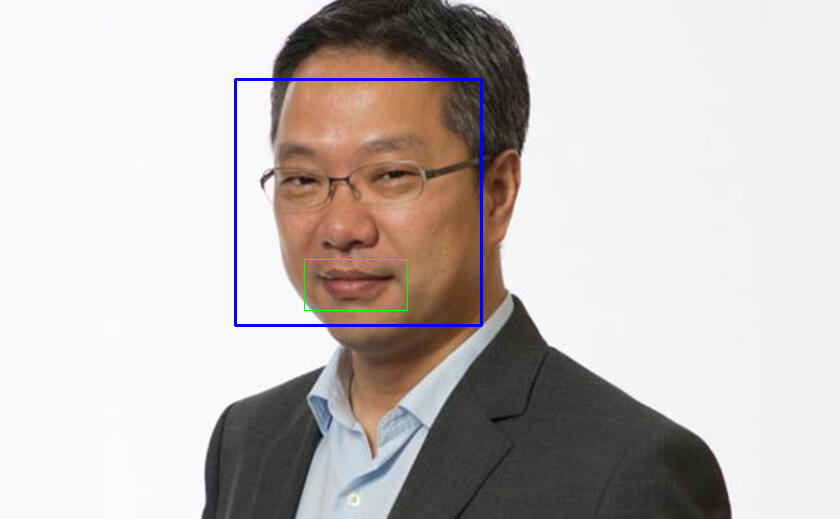

Kelly Shue


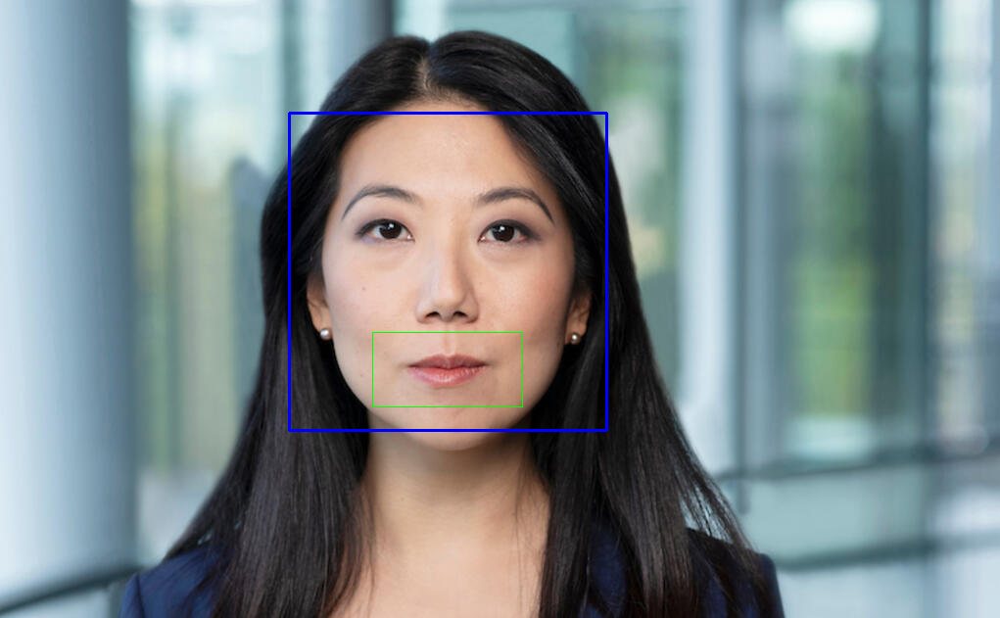

Alp Simsek


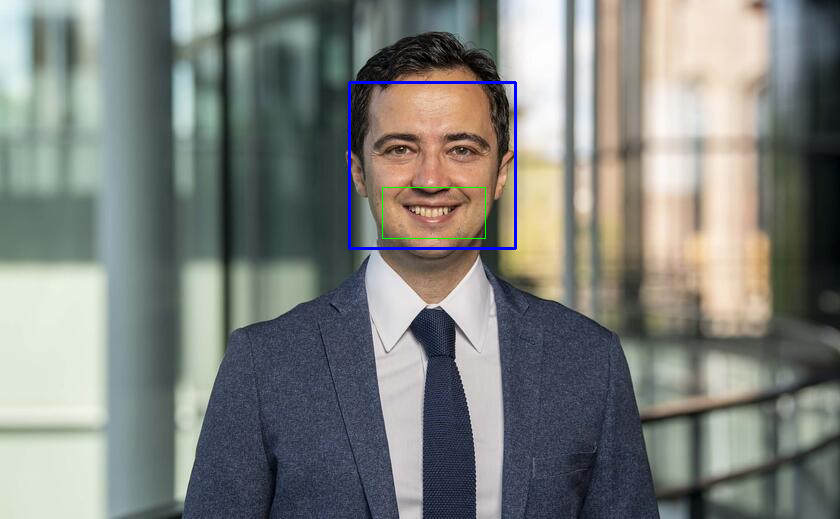

Michael Sinkinson


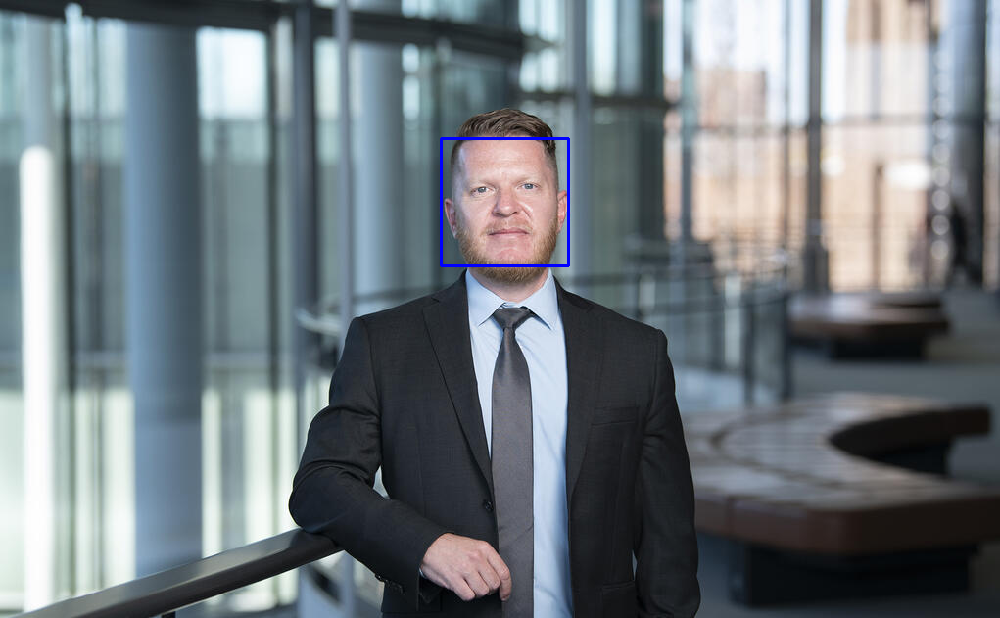

Deborah Small


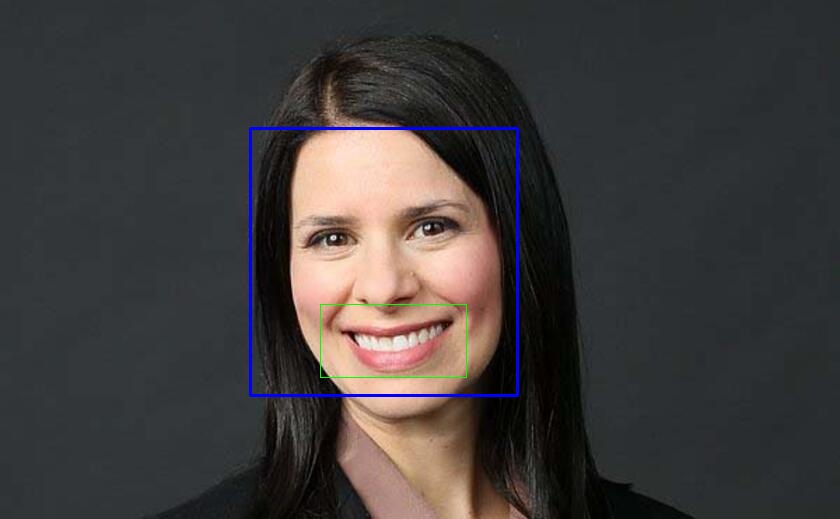

Edward A. Snyder


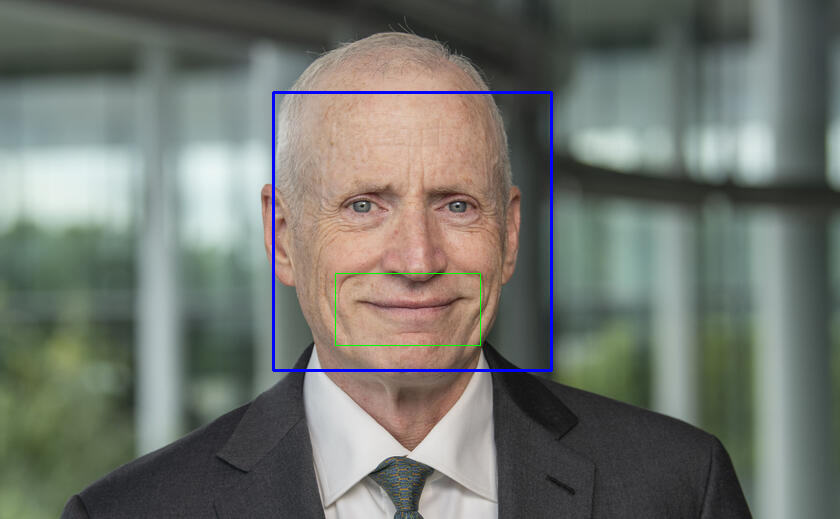

Matthew Spiegel


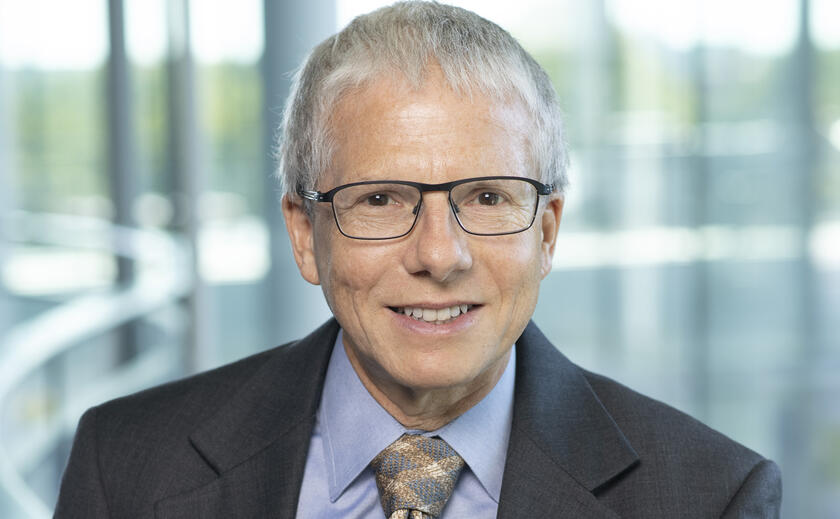

Thomas Steffen


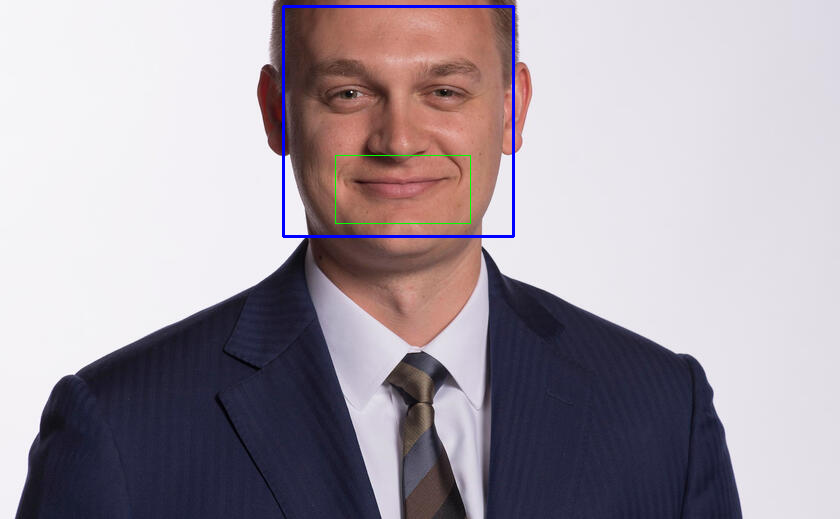

K. Sudhir


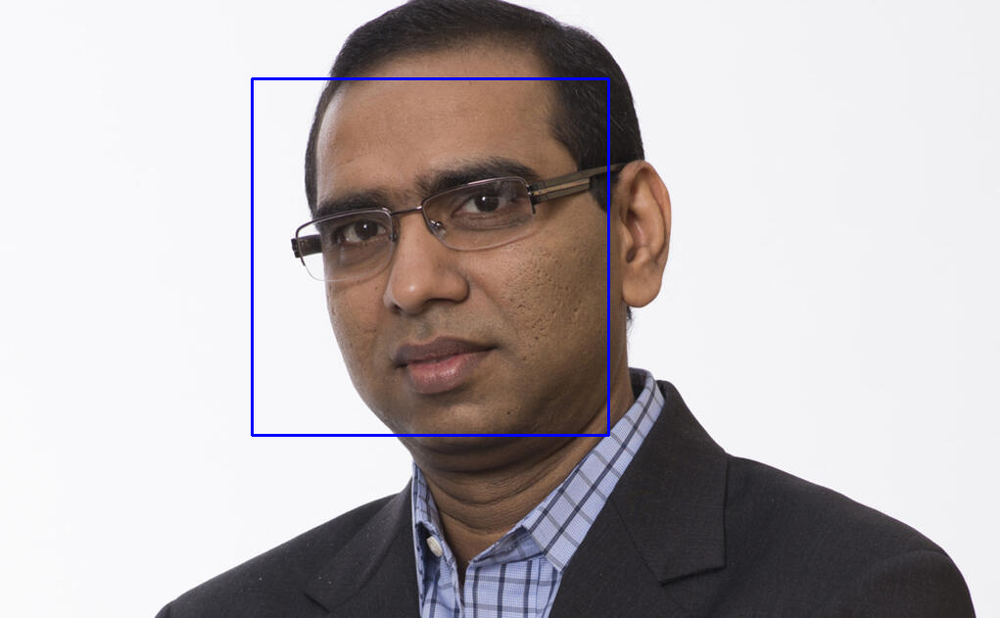

Jacob Thomas


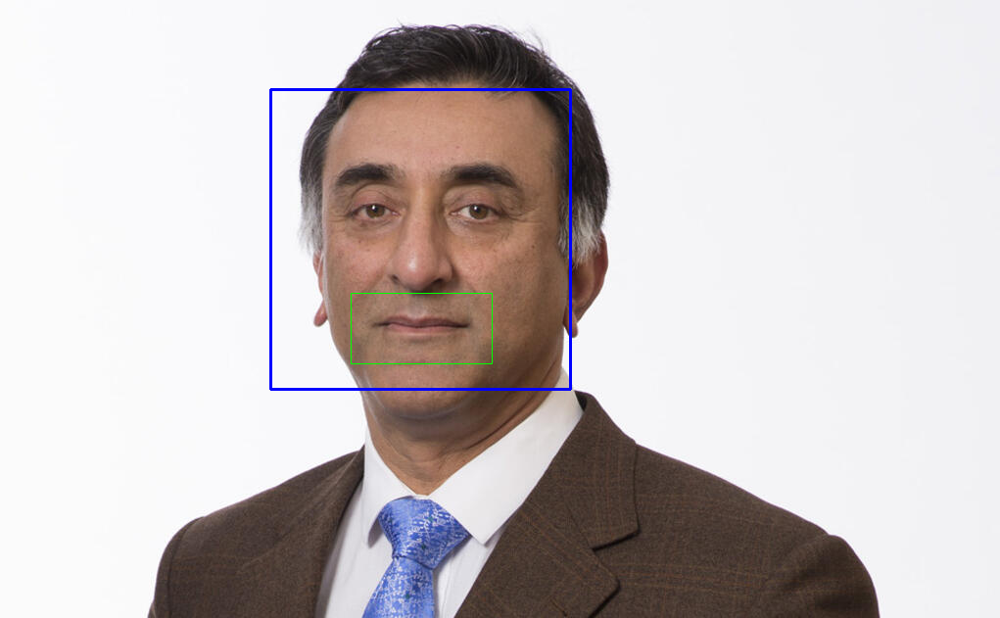

Heather E. Tookes


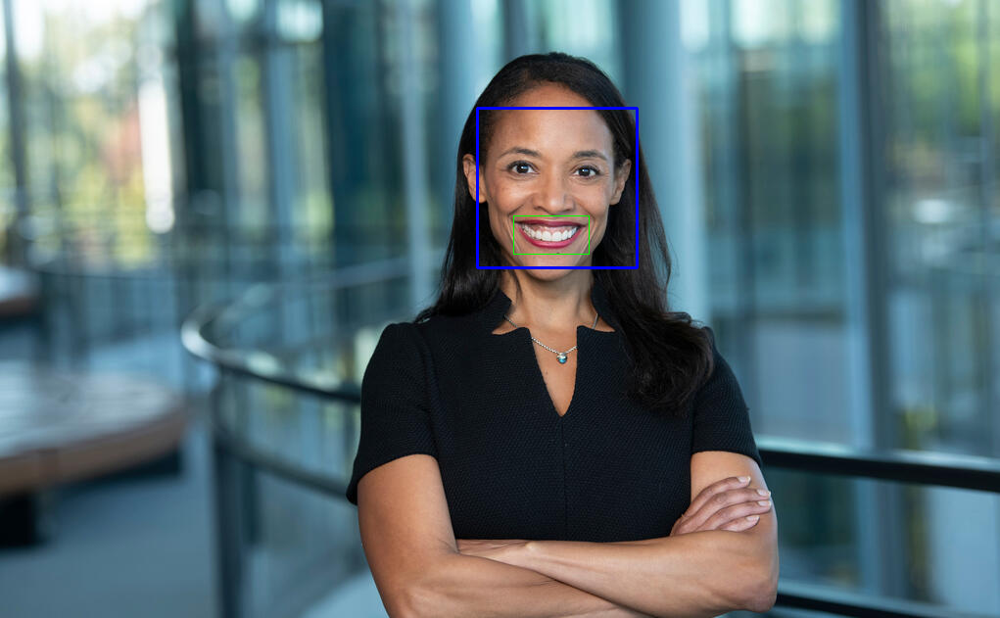

Kosuke Uetake


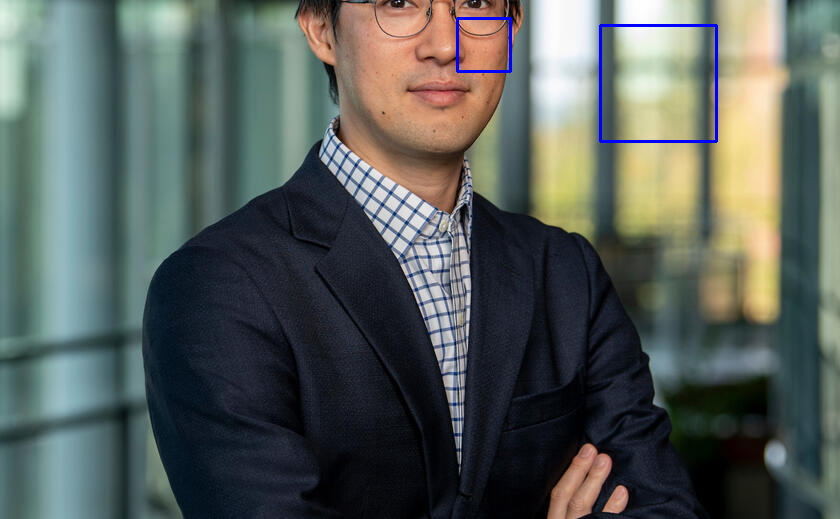

Diana Van Patten


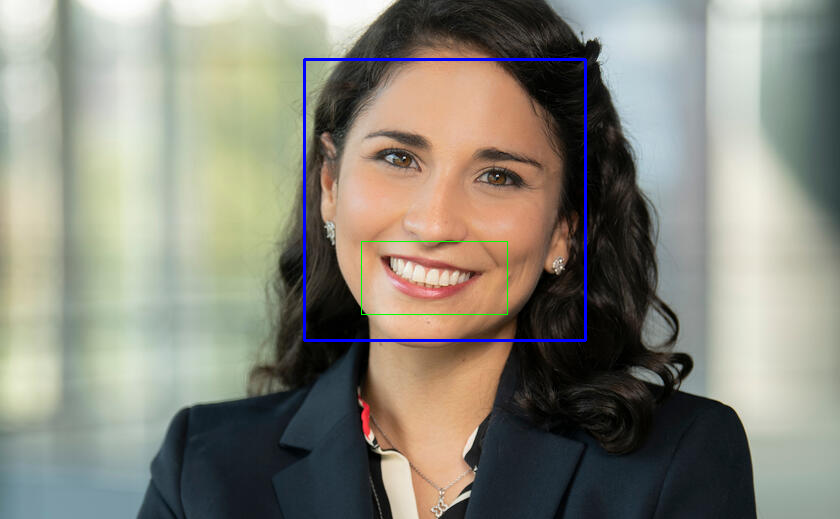

Tong Wang


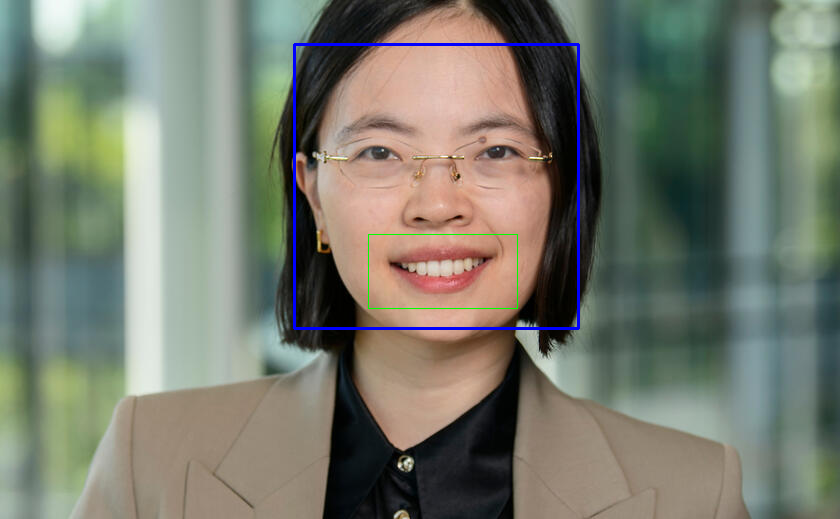

Edward Watts


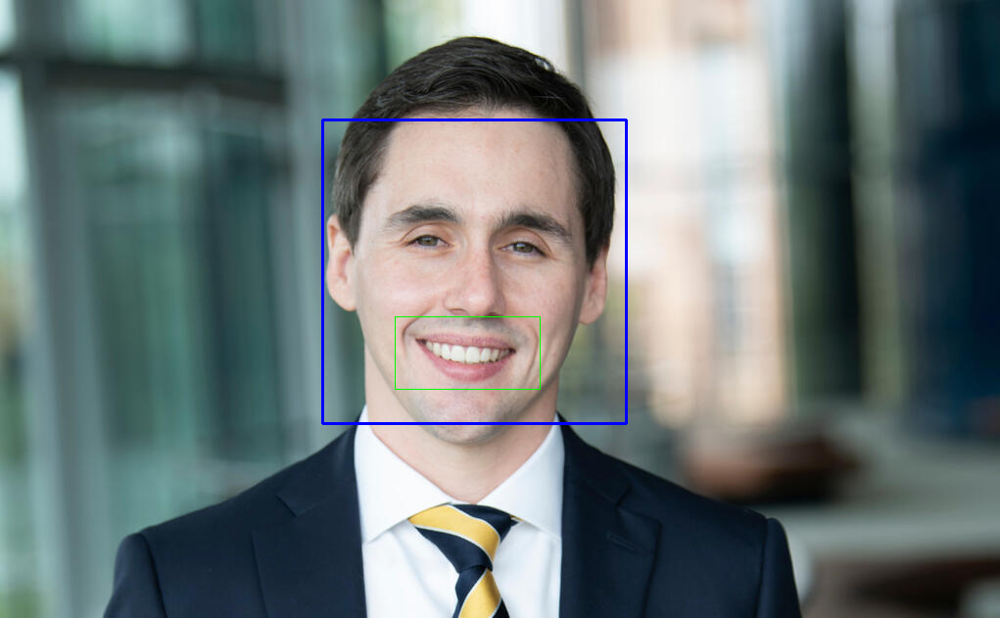

Kevin R. Williams


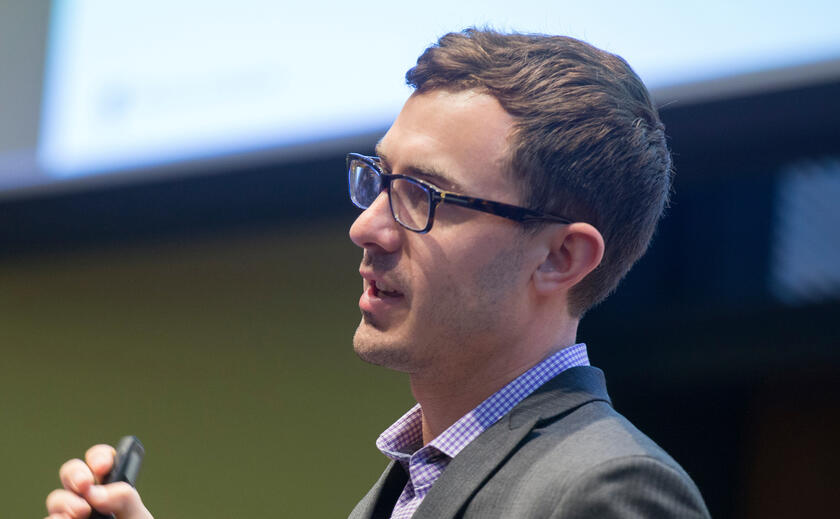

Kai Hao Yang


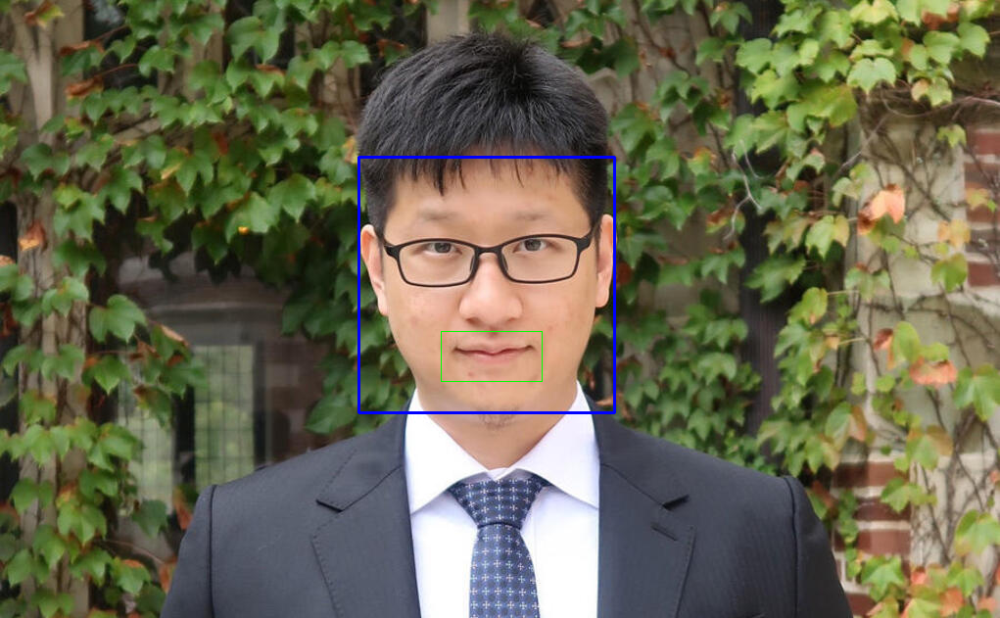

Tauhid Zaman


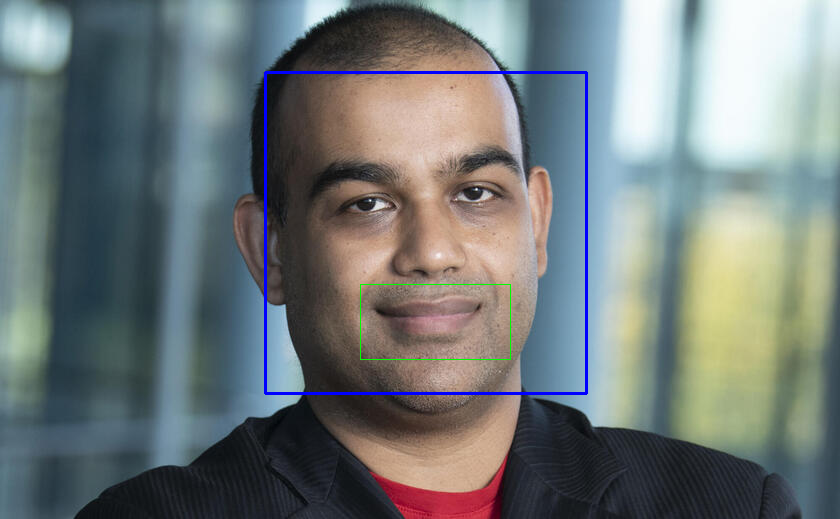

Gal Zauberman


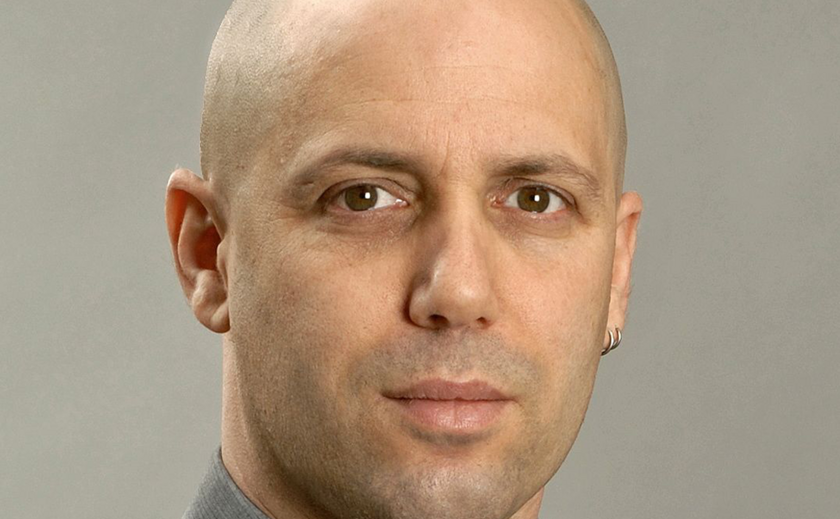

Alexander Zentefis


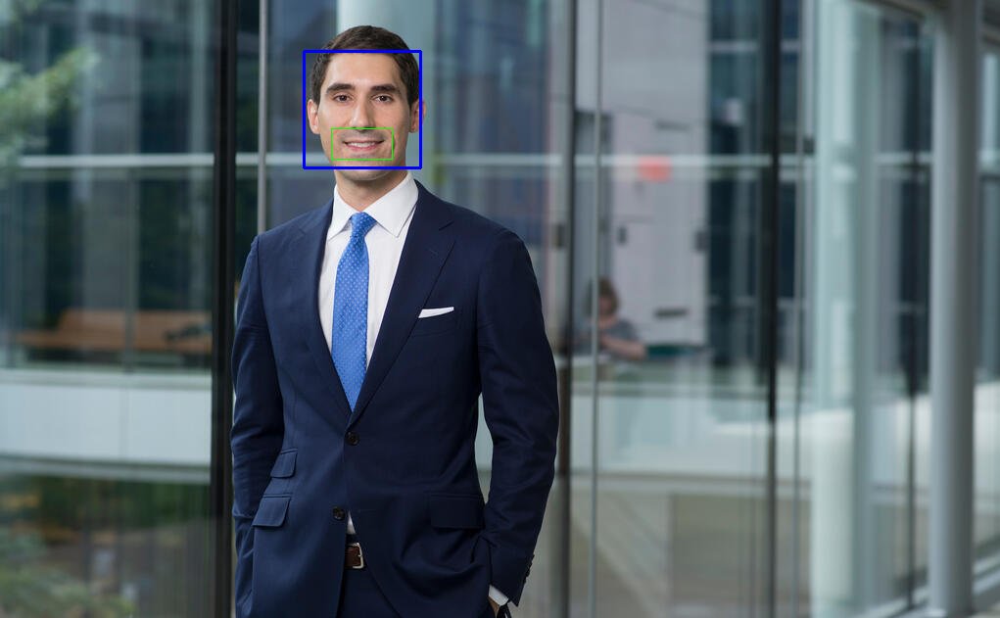

X. Frank Zhang


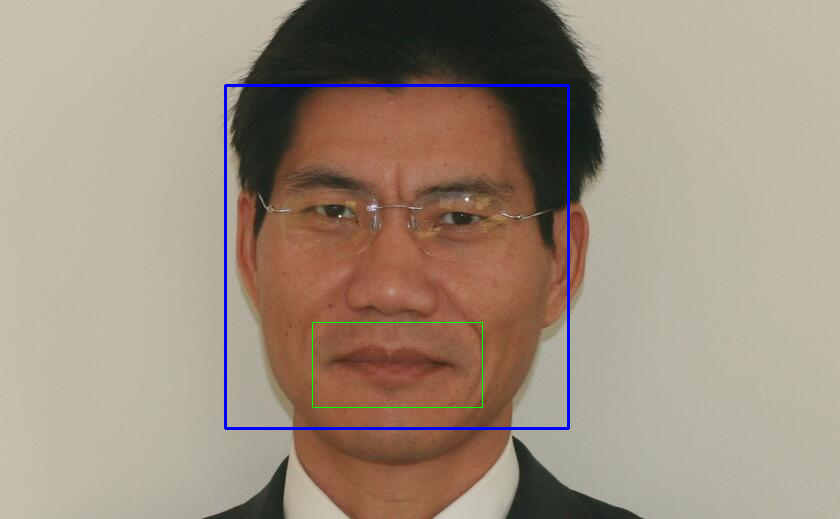

Jidong Zhou


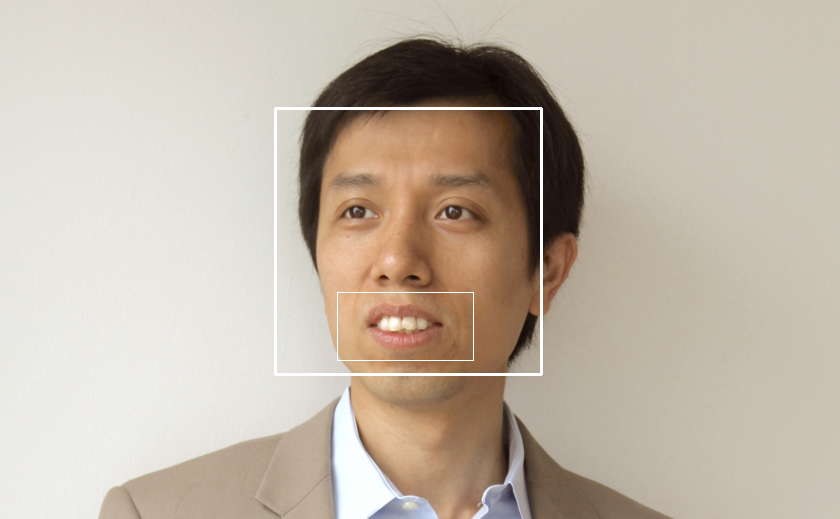

Seth Zimmerman


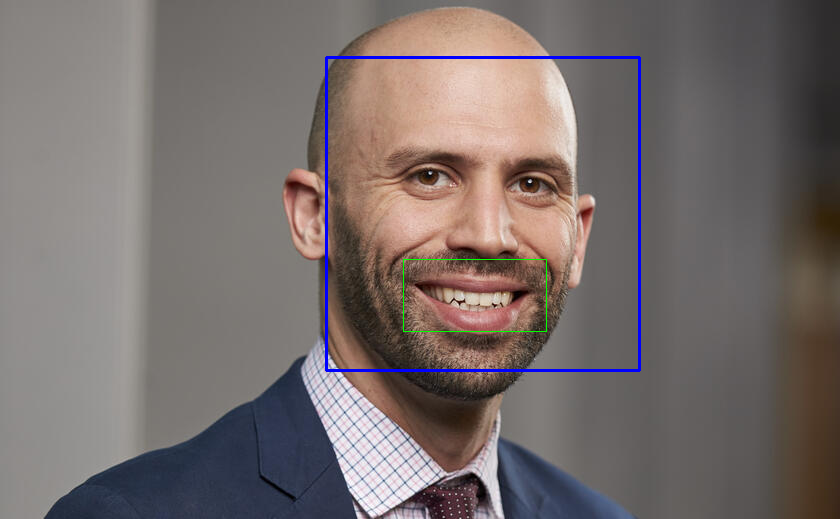

In [ ]:
import cv2
from google.colab.patches import cv2_imshow

face_cascade = cv2.CascadeClassifier(cv2.data.haarcascades + 'haarcascade_frontalface_default.xml')
smile_cascade = cv2.CascadeClassifier(cv2.data.haarcascades + 'haarcascade_smile.xml')

names = []
face_detected = []
smile_detected = []
re_files = []

for index, row in df_SOM_prof.iterrows():
    name = row["Name"]
    new_name = name.lower().replace(".", "").replace(" ", "_")
    filename = f"{new_name}.jpg"

    img = cv2.imread(f'/content/{filename}', -1)

    faces = face_cascade.detectMultiScale(img, scaleFactor=1.3, minNeighbors=5)

    if len(faces) > 0:
        face_var = 1
    else:
        face_var = 0

    for (x, y, w, h) in faces:
        # Draw rectangle around face
        cv2.rectangle(img, (x, y), (x + w, y + h), (255, 0, 0), 2)
        roi_bottom_half = img[y + int(h * 0.6):y + h, x:x + w]

        # Check if the region of interest is not None
        if roi_bottom_half is not None:
            smiles = smile_cascade.detectMultiScale(roi_bottom_half, scaleFactor=1.3, minNeighbors=30)

            if len(smiles) > 0:
                smile_var = 1
            else:
                smile_var = 0

            smile_coordinates = [(x + sx, y + int(h * 0.6) + sy, sw, sh) for (sx, sy, sw, sh) in smiles]
            # Calculate the bounding box for all smiles
            if smile_coordinates:
                min_x = min([x for (x, y, w, h) in smile_coordinates])
                min_y = min([y for (x, y, w, h) in smile_coordinates])
                max_w = max([x + w for (x, y, w, h) in smile_coordinates]) - min_x
                max_h = max([y + h for (x, y, w, h) in smile_coordinates]) - min_y

                # Draw a single larger rectangle around all smiles
                cv2.rectangle(img, (min_x, min_y), (min_x + max_w, min_y + max_h), (0, 255, 0), 1)

    face_detected.append(face_var)
    smile_detected.append(smile_var)
    names.append(name)

    save_filename = f'{new_name}_smile.jpg'
    re_files.append(save_filename)

    cv2.imwrite(save_filename, img)

    print(name)
    cv2_imshow(img)
    cv2.waitKey(0)
    cv2.destroyAllWindows()

# Tilted: Kerwin K. Charles
# Face: Zeqiong Huang, Kosuke Uetake



In [ ]:
df_smile = pd.DataFrame({"Name":names,
                         "Face":face_detected,
                         "Smile":smile_detected
                         })

df_smile.head()

print(df_smile["Face"].value_counts())
print(df_smile["Smile"].value_counts())

1    74
0    12
Name: Face, dtype: int64
1    67
0    19
Name: Smile, dtype: int64


In [ ]:
df_smile.loc[df_smile["Name"] == "Zeqiong Huang", "Face"] = 0
df_smile.loc[df_smile["Name"] == "Kosuke Uetake", "Face"] = 0

print(df_smile["Face"].value_counts())

1    72
0    14
Name: Face, dtype: int64


In [ ]:
df_smile.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 86 entries, 0 to 85
Data columns (total 3 columns):
 #   Column  Non-Null Count  Dtype 
---  ------  --------------  ----- 
 0   Name    86 non-null     object
 1   Face    86 non-null     int64 
 2   Smile   86 non-null     int64 
dtypes: int64(2), object(1)
memory usage: 2.1+ KB


In [ ]:
# Save the file as a zipfile
import zipfile
import os

zip_filename = '2024_yale_images_with_smile.zip'

with zipfile.ZipFile(zip_filename, 'w') as zipf:
  for filename in re_files:
    #print(filename)
    zipf.write(filename)

from google.colab import files
files.download('/content/2024_yale_images_with_smile.zip')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

# Final Touch



In [ ]:
df_result = df_SOM_prof.merge(df_smile, on="Name")

df_result["University"] = "Yale"

df_result = df_result[["University","Name","Department","Rank","Sex","Title","Pronouns","URL","Face","Smile"]]

df_result.head(3)

df_result.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 86 entries, 0 to 85
Data columns (total 10 columns):
 #   Column      Non-Null Count  Dtype 
---  ------      --------------  ----- 
 0   University  86 non-null     object
 1   Name        86 non-null     object
 2   Department  86 non-null     object
 3   Rank        86 non-null     object
 4   Sex         86 non-null     object
 5   Title       86 non-null     object
 6   Pronouns    86 non-null     object
 7   URL         86 non-null     object
 8   Face        86 non-null     int64 
 9   Smile       86 non-null     int64 
dtypes: int64(2), object(8)
memory usage: 7.4+ KB


In [ ]:
print(df_result["Rank"].value_counts(), "\n")
print(df_result["Sex"].value_counts(), "\n")
print(df_result["Face"].value_counts(), "\n")
print(df_result["Smile"].value_counts(), "\n")

Full         46
Assistant    28
Associate    12
Name: Rank, dtype: int64 

Male      63
Female    23
Name: Sex, dtype: int64 

1    72
0    14
Name: Face, dtype: int64 

1    67
0    19
Name: Smile, dtype: int64 



In [ ]:
df_result = df_result[df_result["Rank"] != "Emeritus"]
df_result = df_result[df_result["Sex"] != "Unknown"]
df_result = df_result[df_result["Face"] == 1]

df_result.to_csv("2024_01_Yale_Smile.csv", index=False)
df_result.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 72 entries, 0 to 85
Data columns (total 10 columns):
 #   Column      Non-Null Count  Dtype 
---  ------      --------------  ----- 
 0   University  72 non-null     object
 1   Name        72 non-null     object
 2   Department  72 non-null     object
 3   Rank        72 non-null     object
 4   Sex         72 non-null     object
 5   Title       72 non-null     object
 6   Pronouns    72 non-null     object
 7   URL         72 non-null     object
 8   Face        72 non-null     int64 
 9   Smile       72 non-null     int64 
dtypes: int64(2), object(8)
memory usage: 6.2+ KB


In [ ]:
df = df_result

from scipy.stats import chi2_contingency

contingency_table = pd.crosstab(df["Rank"], df['Smile'])
print(contingency_table, "\n")

chi2, p, dof, expected = chi2_contingency(contingency_table)

print(f"Chi-square statistic: {chi2}")
print(f"P-value: {p}")
print(f"Degrees of freedom: {dof}")
print("Expected frequencies:")
print(expected)

Smile      0   1
Rank            
Assistant  3  23
Associate  3   6
Full       6  31 

Chi-square statistic: 2.2977130977130975
P-value: 0.31699903513218197
Degrees of freedom: 2
Expected frequencies:
[[ 4.33333333 21.66666667]
 [ 1.5         7.5       ]
 [ 6.16666667 30.83333333]]


In [ ]:
df = df_result

from scipy.stats import chi2_contingency

contingency_table = pd.crosstab(df["Sex"], df['Smile'])
print(contingency_table, "\n")

chi2, p, dof, expected = chi2_contingency(contingency_table)

print(f"Chi-square statistic: {chi2}")
print(f"P-value: {p}")
print(f"Degrees of freedom: {dof}")
print("Expected frequencies:")
print(expected)

Smile    0   1
Sex           
Female   2  17
Male    10  43 

Chi-square statistic: 0.22879841112214472
P-value: 0.6324162233134432
Degrees of freedom: 1
Expected frequencies:
[[ 3.16666667 15.83333333]
 [ 8.83333333 44.16666667]]
